<a href="https://colab.research.google.com/github/Mozart17/Nifty-Stocks-Portfolio/blob/main/Refined_nifty.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

I have refined the code by making functions for repetitive parts of the code.
I automated for different testcases that can be used for the portfolio creation and their backtesting part based on my portfolio creation logic. In the end all functions are called in a function called portfolio_logic which when called will perform different iterations in which portfolio will be made and that portfolio will be backtested for a future time frame.

In [71]:
%pip install yfinance
%pip install seaborn
%pip install networkx
%pip install scipy
%pip install niftystocks


In [72]:
import yfinance as yf
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np


# msft = yf.Ticker("NSEI.NS")

# # get historical market data
# hist = msft.history(period="5d")



These was just to understand syntax


In [73]:
import pandas as pd

1. Data Collection

In [74]:
# all_symbols = [
#     "ADANIENT", "ADANIGREEN", "ADANIPORTS", "ADANITRANS", "AMBUJACEM",
#     "APOLLOHOSP", "ASIANPAINT", "AXISBANK", "BAJAJ-AUTO", "BAJAJFINSV",
#     "BAJFINANCE", "BHARTIARTL", "BPCL", "BRITANNIA", "CIPLA",
#     "COALINDIA", "DIVISLAB", "DRREDDY", "EICHERMOT", "GRASIM",
#     "HCLTECH", "HDFC", "HDFCBANK", "HDFCLIFE", "HEROMOTOCO",
#     "HINDALCO", "HINDUNILVR", "ICICIBANK", "INDUSINDBK", "INFY",
#     "ITC", "JSWSTEEL", "KOTAKBANK", "LT", "M&M",
#     "MARUTI", "NESTLEIND", "NTPC", "ONGC", "POWERGRID",
#     "RELIANCE", "SBILIFE", "SBIN", "SUNPHARMA", "TATACONSUM",
#     "TATAMOTORS", "TATASTEEL", "TCS", "TECHM", "ULTRACEMCO"
# ]

# get_data_till_present(all_symbols, "6mo")
# yf.Ticker("ADANIPORTS.NS").history(period="1mo").to_csv(f"{stock_symbols[0]}.csv")

In [75]:
# all_symbols = [
#     "RELIANCE",
#     "TCS",
#     "HDFCBANK",
#     "INFY",
#     "HINDUNILVR",
#     "ICICIBANK",
#     "KOTAKBANK",
#     "BHARTIARTL",
#     "ITC",
#     "SBIN",
#     # "BAJFINANCE",
#     "WIPRO",
#     "HCLTECH",
#     "ASIANPAINT",
#     "MARUTI",
#     "NESTLEIND",
#     "LT",
#     "SUNPHARMA",
#     "ULTRACEMCO",
#     "ADANIGREEN",
#     "ADANIPORTS",
#     "HDFCLIFE",
#     "AXISBANK",
#     "DIVISLAB",
#     "TITAN",
#     "POWERGRID",
#     "BAJAJ-AUTO",
#     "JSWSTEEL",
#     "ADANITRANS",
#     "HINDALCO",
#     "TECHM",
#     "GRASIM",
#     "TATASTEEL",
#     "NTPC",
#     "ONGC",
#     "COALINDIA",
#     "SBILIFE",
#     "ADANIENT",
#     "M&M",
#     "BPCL",
#     "DRREDDY",
#     "BRITANNIA",
#     "HEROMOTOCO",
#     "CIPLA",
#     "INDUSINDBK",
#     "SHREECEM",
#     "UPL",
#     "IOC",
#     "VEDL",
#     "BAJAJFINSV",
#     "EICHERMOT",
#     "DMART",
#     "PIDILITIND",
#     "MUTHOOTFIN",
#     "LUPIN",
#     "HAVELLS",
#     "APOLLOHOSP",
#     "TATAMOTORS",
#     "DABUR",
#     "TATACONSUM",
#     "AUROPHARMA",
#     "ICICIPRULI",
#     "BANDHANBNK",
#     "PETRONET",
#     "BERGEPAINT",
#     "PIIND",
#     "BIOCON",
#     "NAUKRI",
#     "AMBUJACEM",
#     "CONCOR",
#     "INDIGO",
#     "GODREJCP",
#     "MRF",
#     "MANAPPURAM",
#     "ICICIGI",
#     "TORNTPHARM",
#     "MCDOWELL-N",
#     "GAIL",
#     "BEL",
#     "EXIDEIND",
#     "MFSL",
#     "SRTRANSFIN",
#     "LTI",
#     "BALKRISIND",
#     "IGL",
#     "TATAELXSI",
#     "SRF",
#     "ACC",
#     "RECLTD",
#     "IDFCFIRSTB",
#     "NESTLEIND",
#     "BANKBARODA",
#     "HINDPETRO",
#     "SUNTV",
#     "PAGEIND",
#     "COLPAL",
#     "M&MFIN",
#     "SYNGENE",
#     "COFORGE",
#     "GLENMARK",
#     "GMRINFRA",
#     "TATAPOWER",
#     "ALKEM"
# ]


In [76]:
import pandas as pd


In [77]:
def get_historical_data(all_symbols, start_date, end_date):
    data = []
    returns_tp = pd.DataFrame(data, columns = ["NAN"])
    # returns_tp.head()
    # data_df = pd.DataFrame(yf.Ticker(f"ADANIENT.NS").history(period="6mo")["Date"])
    cols = 1
    problematic = []
    for symbol in all_symbols:
        # print(symbol)

        df = yf.Ticker(f"{symbol}").history(start=start_date, end=end_date)
        if len(df) == 0:
            print(f"Problem at {symbol}")
            problematic.append(symbol)
        # print(df.head())
        changes = []
        changes.append(0)
        for index in range(len(df)):
            if index>0:
                # print((df.loc[df.index[index]]["Close"] - df.loc[df.index[index-1]]["Close"])/df.loc[df.index[index-1]]["Close"])
                changes.append(((df.loc[df.index[index]]["Close"] - df.loc[df.index[index-1]]["Close"])/df.loc[df.index[index-1]]["Close"])*100)

        df.insert(2, "Returns", changes, True)
        returns_tp.insert(cols, f"{symbol}", df[["Returns"]], True)
        data.append({f"{symbol}":df[["Open", "Close", "Returns"]]})
        cols+=1

    problematic.append("NAN")


    # returns_tp = returns_tp.dropna()
    # print(returns_tp.head(), data, problematic)
    return returns_tp, data, problematic

# returns_tp, data, problematic = get_historical_data(all_symbols, start_date = "2024-02-01", end_date="2024-08-01")

In [78]:
def remove_these_stocks(df, stocks):
    df = df.drop(stocks, axis=1)
    return df

# returns_tp = remove_these_stocks(returns_tp, problematic)

2. Correalatiion

In [79]:
def find_cor_matrix(df):
    cor_matrix = df.corr()
    return cor_matrix

# cor_matrix = find_cor_matrix(returns_tp)

In [80]:
def save_df(df, name_of_file):
    df.to_csv(f"{name_of_file}.csv")

# save_df(returns_tp, "market_data")

In [81]:
def print_heat_map(matrix):
    plt.figure(figsize=(30, 25))
    sns.heatmap(matrix, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.show()

# print_heat_map(cor_matrix)

3.Clustering

 top down clustering.

please ignore the graph, as i couldnt get hang to how to make sense for portfolio selection.

Top Down Clustering:

In [82]:
%pip install scikit-learn

In [83]:
import numpy as np
import pandas as pd
import sklearn
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
import matplotlib.pyplot as plt

# Assuming cor_matrix is your DataFrame
def top_down(cor_matrix):
    dist_matrix = 1 - cor_matrix

    def divisive_clustering(distance_matrix, num_clusters):
        clusters = [list(range(len(distance_matrix)))]

        while len(clusters) < num_clusters:
            largest_cluster = max(clusters, key=len)
            clusters.remove(largest_cluster)

            sub_matrix = distance_matrix[np.ix_(largest_cluster, largest_cluster)]

            kmeans = KMeans(n_clusters=2).fit(sub_matrix)
            labels = kmeans.labels_

            cluster1 = [largest_cluster[i] for i in range(len(largest_cluster)) if labels[i] == 0]
            cluster2 = [largest_cluster[i] for i in range(len(largest_cluster)) if labels[i] == 1]

            clusters.append(cluster1)
            clusters.append(cluster2)

        return clusters

    num_clusters = 10
    clusters = divisive_clustering(dist_matrix.values, num_clusters)

    # Convert clusters back to stock names
    stock_names = cor_matrix.columns
    for i, cluster in enumerate(clusters):
        print(f"Cluster {i+1}: {[stock_names[idx] for idx in cluster]}")

    # Optionally visualize with a dendrogram
    # from scipy.cluster.hierarchy import linkage, dendrogram

    # linkage_matrix = linkage(dist_matrix, method='ward')
    # plt.figure(figsize=(10, 7))
    # dendrogram(linkage_matrix, labels=cor_matrix.columns, orientation='top', distance_sort='descending')
    # plt.title('Dendrogram for Divisive Clustering')
    # plt.xlabel('Stocks')
    # plt.ylabel('Distance')
    # plt.show()
    return clusters, stock_names

# clusters, stock_names = top_down(cor_matrix)

4.Selection

In [84]:
def find_returns(data):
    print(data[0])
    index = 0
    returns = []
    for index in range(len(data)):
        keys = data[index].keys()
        # print(list(keys)[0])
        symbol = list(keys)[0]
        try:
            # print(data[index])

            first_close = data[index][symbol]["Close"][0]
            last_close = data[index][symbol]["Close"][-1]
            returns.append({symbol: (((last_close - first_close)/first_close)*100)})
            # index+=1
        finally:
            continue
      #break
    # print(returns)
    return returns

# returns = find_returns(data)

In [85]:
import pandas as pd

# Convert the returns list to a DataFrame
def find_top_stocks(returns, clusters, stock_names):
    returns_df = pd.DataFrame(returns)

    # Ensure the DataFrame is in the correct shape
    returns_df = returns_df.melt(var_name='Stock', value_name='Return')
    returns_df = returns_df.dropna()  # Drop any NaN values that might have been introduced

    # Set 'Stock' as the index
    returns_df.set_index('Stock', inplace=True)

    # Initialize a list to hold the top stocks from each cluster
    top_stocks = []
    for i, cluster in enumerate(clusters):
        cluster_stocks = [stock_names[idx] for idx in cluster]
        cluster_returns = returns_df.loc[cluster_stocks]
        sorted_stocks = cluster_returns.sort_values(by='Return', ascending=False)
        top_2_stocks = sorted_stocks.head(2)
        top_stocks.append(top_2_stocks)

    return top_stocks


# top_stocks = find_top_stocks(returns, clusters, stock_names)

In [86]:
def find_indices_return(start_date, end_date):
# Define the period for the past 6 months
# start_date = "2024-02-08"
# end_date = "2024-08-08"

# Fetch historical data for NIFTY 50, NIFTY 500, and SENSEX
    print(start_date, end_date)
    nifty50 = yf.download("^NSEI", start=start_date, end=end_date)
    if len(nifty50)==0:
        nifty50 = pd.DataFrame([0,0])
    nifty50 = [0, 0] if len(nifty50)==0 else nifty50
    nifty500 = yf.download("^CRSLDX", start=start_date, end=end_date)  # NIFTY 500 index might have different ticker
    nifty500 = [0, 0] if len(nifty500) == 0 else nifty500
    sensex = yf.download("^BSESN", start=start_date, end=end_date)
    sensex = [0, 0] if len(sensex)==0 else sensex
    nifty50_return = ((nifty50['Close'][-1] - nifty50['Close'][0]) / nifty50['Close'][0]) * 100 if nifty50 is not [0, 0] else 0
    nifty500_return = ((nifty500['Close'][-1] - nifty500['Close'][0]) / nifty500['Close'][0]) * 100 if nifty500 is not [0, 0] else 0
    sensex_return = ((sensex['Close'][-1] - sensex['Close'][0]) / sensex['Close'][0]) * 100 if sensex is not [0, 0] else 0

    print(f"NIFTY 50 from {start_date} to {end_date} Return: {nifty50_return:.2f}%")
    print(f"NIFTY 500 from {start_date} to {end_date} Return: {nifty500_return:.2f}%")
    print(f"SENSEX from {start_date} to {end_date} Return: {sensex_return:.2f}%")

    return nifty50_return, nifty500_return, sensex_return

# nifty50_return, nifty500_return, sensex_return = find_indices_return("2024-02-08", "2024-08-08")

In [87]:
# Calculate the average return of your portfolio
def find_portfolio_avg(portfolio, period):
    portfolio_avg_return = portfolio['Return'].mean()

    print(f"Portfolio Average {period} Return: {portfolio_avg_return:.2f}%")

    return portfolio_avg_return

# portfolio_avg_return = find_portfolio_avg(final_portfolio, "6 month")

In [88]:
import matplotlib.pyplot as plt

# Data for visualization
def plot_comparison(portfolio_avg_return, nifty50_return, nifty500_return, sensex_return, start, end):
    labels = ['Portfolio', 'NIFTY 50', 'NIFTY 500', 'SENSEX']
    returns = [portfolio_avg_return, nifty50_return, nifty500_return, sensex_return]

    # Create bar plot
    plt.figure(figsize=(5, 3))
    plt.bar(labels, returns, color=['blue', 'green', 'orange', 'red'])
    plt.xlabel('Investment')
    plt.ylabel(f'{start} to {end} Return (%)')
    plt.title('Comparison of Portfolio Return with Benchmark Indices')
    plt.show()

# plot_comparison(portfolio_avg_return, nifty50_return, nifty500_return, sensex_return)

BACKTESTING


In [89]:
# start_date = ""
# start_date.split
import datetime
# print()

def next_period(start_date, end_date):
    s_year, s_month, s_day = start_date.split("-")
    e_year, e_month, e_day = end_date.split("-")
    st = datetime.date(int(s_year), int(s_month), int(s_day))
    en = datetime.date(int(e_year), int(e_month), int(e_day))
    period = en - st

    # year = start_date.split("-")[0]
    new_st = st + period
    new_en = en + period
    if new_en>datetime.date.today():
        new_en = datetime.date.today()
    print(new_st, new_en)
    return f"{new_st}", f"{new_en}"




In [90]:
def make_portfolio(start_date, end_date, all_symbols):
    returns_tp, data, problematic = get_historical_data(all_symbols, start_date = start_date, end_date=end_date)
    print(problematic)
    returns_tp = remove_these_stocks(returns_tp, problematic)
    cor_matrix = find_cor_matrix(returns_tp)
    print_heat_map(cor_matrix)
    clusters, stock_names = top_down(cor_matrix)
    returns = find_returns(data)
    top_stocks = find_top_stocks(returns, clusters, stock_names)
    return pd.concat(top_stocks)

In [91]:
import warnings
warnings.filterwarnings("ignore")
def perform_portfolio_logic(start_date, end_date, overall_data, all_symbols):
    backtest_start_date, backtest_end_date = next_period(start_date, end_date)


    # save_df(returns_tp, "market_data")

    # G_high, G_low, G_negative, G = get_g(cor_matrix)
    # # Plot each subgraph
    # plot_graph(G_high, 'High Correlation Clusters')
    # plot_graph(G_low, 'Low Correlation Clusters')
    # plot_graph(G_negative, 'Negative Correlation Clusters')

    final_portfolio = make_portfolio(start_date, end_date,all_symbols)

    portfolio_avg_return = find_portfolio_avg(final_portfolio, f"From {start_date} to {end_date}")
    nifty50_return, nifty500_return, sensex_return = find_indices_return(backtest_start_date, backtest_end_date)

    # plot_comparison(portfolio_avg_return, nifty50_return, nifty500_return, sensex_return, start_date, end_date)

    portfolio_stock_names = []
    for i in range(len(final_portfolio)):
        # print(final_portfolio.iloc[i].name)
        portfolio_stock_names.append(final_portfolio.iloc[i].name)
    # print("portfolio:\n", portfolio_stock_names)
    # print("---------------")
    returns_tp, data, problematic = get_historical_data(portfolio_stock_names, start_date = backtest_start_date, end_date=backtest_end_date)
    returns = find_returns(data)
    def avg_return(returns):
        sum = 0
        for r in returns:
            # print(r)
            sum += list(r.values())[0]
            # print(list(r.values())[0])

        avg = sum/len(returns)
        return avg

    avg = avg_return(returns)
    print(f"Portfolio average from {backtest_start_date} to {backtest_end_date}: {avg}")
    desc = f"Created portfolio using data from {start_date} to {end_date} and tested it against the time period of {backtest_start_date} to {backtest_end_date}"
    portfolio_test_return = avg
    indices_return = [nifty50_return, nifty500_return, sensex_return]
    overall_data.append({
        "desc": desc,
        "portfolio_test_return": portfolio_test_return,
        "indices_return": indices_return,
        "portfolio": returns
    })
    # plot_comparison(avg, nifty50_return, nifty500_return, sensex_return, comparison_start_date, comparison_end_date)
    print(returns)
    beat = 0
    for index in nifty50_return, nifty500_return, sensex_return:
        if(avg>index):
            beat += 1

    print(f"beat {beat}/3")

    return [True, overall_data] if beat>1 else [False, overall_data]


In [92]:

# perform_vlvg_portfolio_logic("2021-04-01", "2022-04-01")
def add_test_cases(start, td):
    test_cases = []
    td = datetime.timedelta(days = td)
    fy = start - td
    # print(datetime.date.today() - td)
    # test_cases_1yr = []
    for i in range(3):
        test_cases.append([fy-td, fy])
        fy = fy - td

    return test_cases

# test_cases = [["2021-04-01", "2022-04-01"], ["2020-04-01", "2021-04-01"], ["2019-04-01", "2020-04-01"], ["2024-01-01", "2022-04-01"], ["2021-04-01", "2022-04-01"]]

In [93]:

test_cases = []

In [94]:
start = datetime.date.today()

test_cases.append(add_test_cases(datetime.date(2024, 4, 1), 365))
test_cases.append(add_test_cases(start, 182))
test_cases.append(add_test_cases(start, 91))
test_cases.append(add_test_cases(start, 60))
test_cases.append(add_test_cases(start, 730))
test_cases.append(add_test_cases(datetime.date(2024, 4, 1), 730))

In [95]:
print(test_cases)

[[[datetime.date(2022, 4, 2), datetime.date(2023, 4, 2)], [datetime.date(2021, 4, 2), datetime.date(2022, 4, 2)], [datetime.date(2020, 4, 2), datetime.date(2021, 4, 2)]], [[datetime.date(2023, 8, 13), datetime.date(2024, 2, 11)], [datetime.date(2023, 2, 12), datetime.date(2023, 8, 13)], [datetime.date(2022, 8, 14), datetime.date(2023, 2, 12)]], [[datetime.date(2024, 2, 11), datetime.date(2024, 5, 12)], [datetime.date(2023, 11, 12), datetime.date(2024, 2, 11)], [datetime.date(2023, 8, 13), datetime.date(2023, 11, 12)]], [[datetime.date(2024, 4, 13), datetime.date(2024, 6, 12)], [datetime.date(2024, 2, 13), datetime.date(2024, 4, 13)], [datetime.date(2023, 12, 15), datetime.date(2024, 2, 13)]], [[datetime.date(2020, 8, 12), datetime.date(2022, 8, 12)], [datetime.date(2018, 8, 13), datetime.date(2020, 8, 12)], [datetime.date(2016, 8, 13), datetime.date(2018, 8, 13)]], [[datetime.date(2020, 4, 2), datetime.date(2022, 4, 2)], [datetime.date(2018, 4, 3), datetime.date(2020, 4, 2)], [datetime

In [96]:

# for data in overall_data:
#     print(data)

from niftystocks import ns

all_symbols = ns.get_nifty50_with_ns()


2023-04-02 2024-04-01


ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


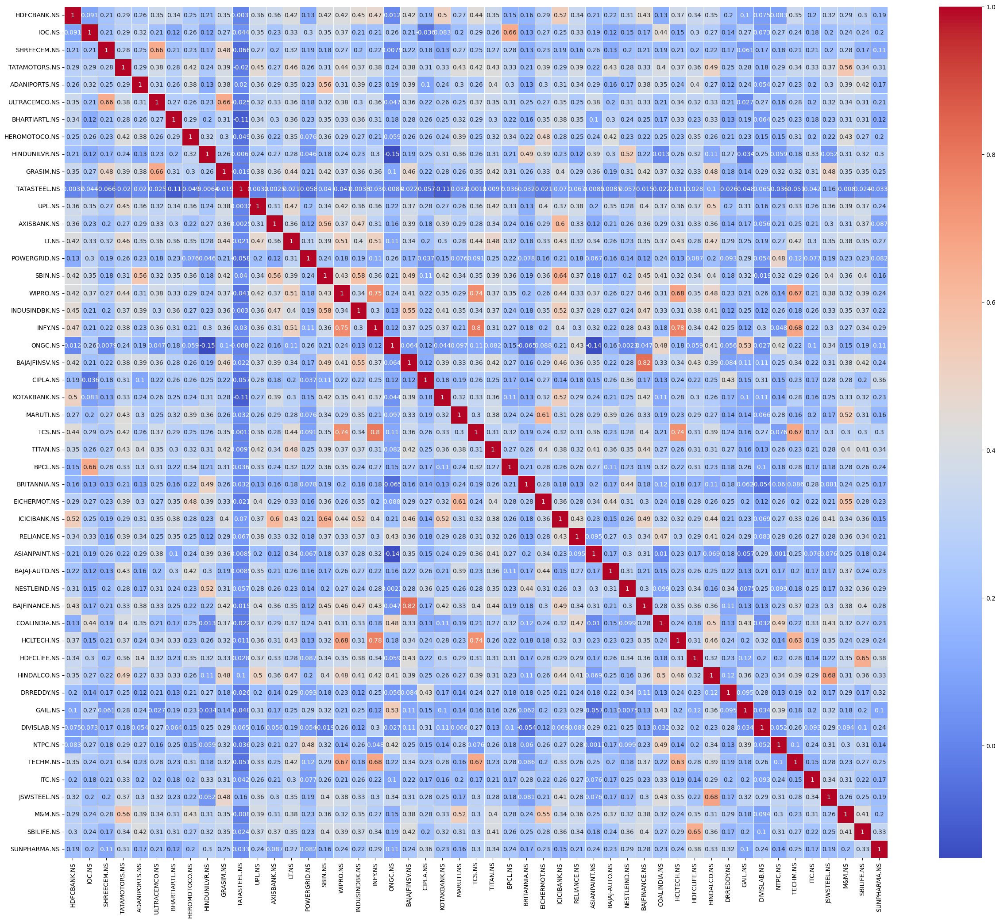

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 3: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 4: ['TATASTEEL.NS']
Cluster 5: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'NESTLEIND.NS', 'ITC.NS']
Cluster 6: ['SHREECEM.NS', 'CIPLA.NS', 'ASIANPAINT.NS', 'BAJAJ-AUTO.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 7: ['UPL.NS', 'LT.NS', 'RELIANCE.NS', 'COALINDIA.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 8: ['ADANIPORTS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'SBILIFE.NS']
Cluster 9: ['TATAMOTORS.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'M&M.NS']
Cluster 10: ['BHARTIARTL.NS', 'HEROMOTOCO.NS', 'HDFCLIFE.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2022-04-04 00:00:00+05:30  1523.330731  1597.37


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2023-04-02 to 2024-04-01 Return: 28.33%
NIFTY 500 from 2023-04-02 to 2024-04-01 Return: 38.72%
SENSEX from 2023-04-02 to 2024-04-01 Return: 24.61%
{'HCLTECH.NS':                                   Open        Close   Returns
Date                                                         
2023-04-03 00:00:00+05:30  1022.676895  1030.370850  0.000000
2023-04-05 00:00:00+05:30  1018.360753  1042.615234  1.188347
2023-04-06 00:00:00+05:30  1040.598057  1024.459595 -1.741356
2023-04-10 00:00:00+05:30  1024.459744  1035.015381  1.030376
2023-04-11 00:00:00+05:30  1035.859735  1019.908997 -1.459532
...                                ...          ...       ...
2024-03-21 00:00:00+05:30  1574.625817  1562.679077  0.548176
2024-03-22 00:00:00+05:30  1527.622124  1525.516724 -2.378118
2024-03-26 00:00:00+05:30  1529.825439  1529.825439  0.282443
2024-03-27 00:00:00+05:30  1536.435354  1514.108521 -1.027367
2024-03-28 00:00:00+05:30  1516.850387  1511.513550 -0.171386

[243 rows x 3 col

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


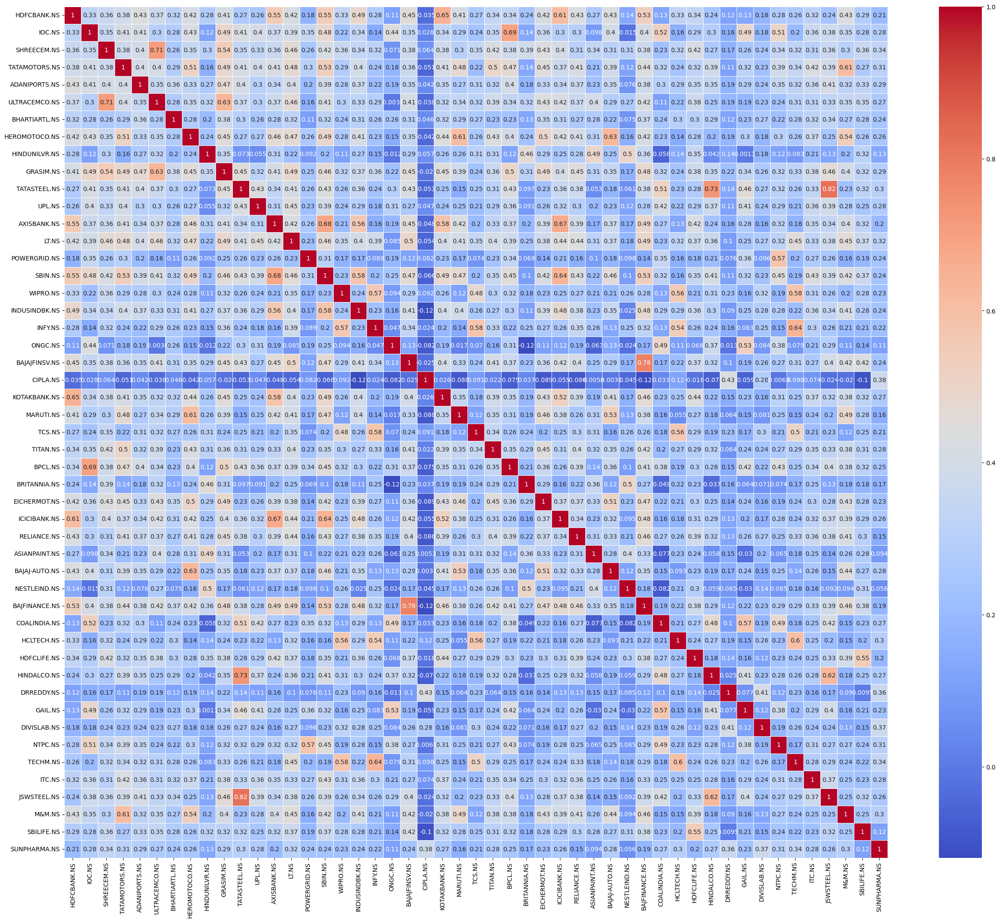

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS']
Cluster 2: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 3: ['TATAMOTORS.NS', 'HEROMOTOCO.NS', 'MARUTI.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS']
Cluster 4: ['SHREECEM.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'LT.NS']
Cluster 5: ['TATASTEEL.NS', 'UPL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 6: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 7: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 8: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 9: ['BAJAJFINSV.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 10: ['ADANIPORTS.NS', 'BHARTIARTL.NS', 'TITAN.NS', 'RELIANCE.NS', 'ITC.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2021-04-05 00:00:00+05:30  1420.768459  1391.58


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2022-04-02 to 2023-04-02 Return: -3.84%
NIFTY 500 from 2022-04-02 to 2023-04-02 Return: -5.37%
SENSEX from 2022-04-02 to 2023-04-02 Return: -2.67%
{'ASIANPAINT.NS':                                   Open        Close   Returns
Date                                                         
2022-04-04 00:00:00+05:30  3047.189119  3040.412109  0.000000
2022-04-05 00:00:00+05:30  3032.611151  3062.644775  0.731239
2022-04-06 00:00:00+05:30  3058.939626  3075.516602  0.420285
2022-04-07 00:00:00+05:30  3075.516583  3076.491699  0.031705
2022-04-08 00:00:00+05:30  3089.168114  3126.466309  1.624403
...                                ...          ...       ...
2023-03-24 00:00:00+05:30  2747.861371  2748.548828  0.025019
2023-03-27 00:00:00+05:30  2748.549031  2753.705322  0.187608
2023-03-28 00:00:00+05:30  2741.182892  2734.749756 -0.688366
2023-03-29 00:00:00+05:30  2734.749784  2721.048828 -0.500994
2023-03-31 00:00:00+05:30  2706.856789  2712.356689 -0.319441

[248 rows x 3 

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


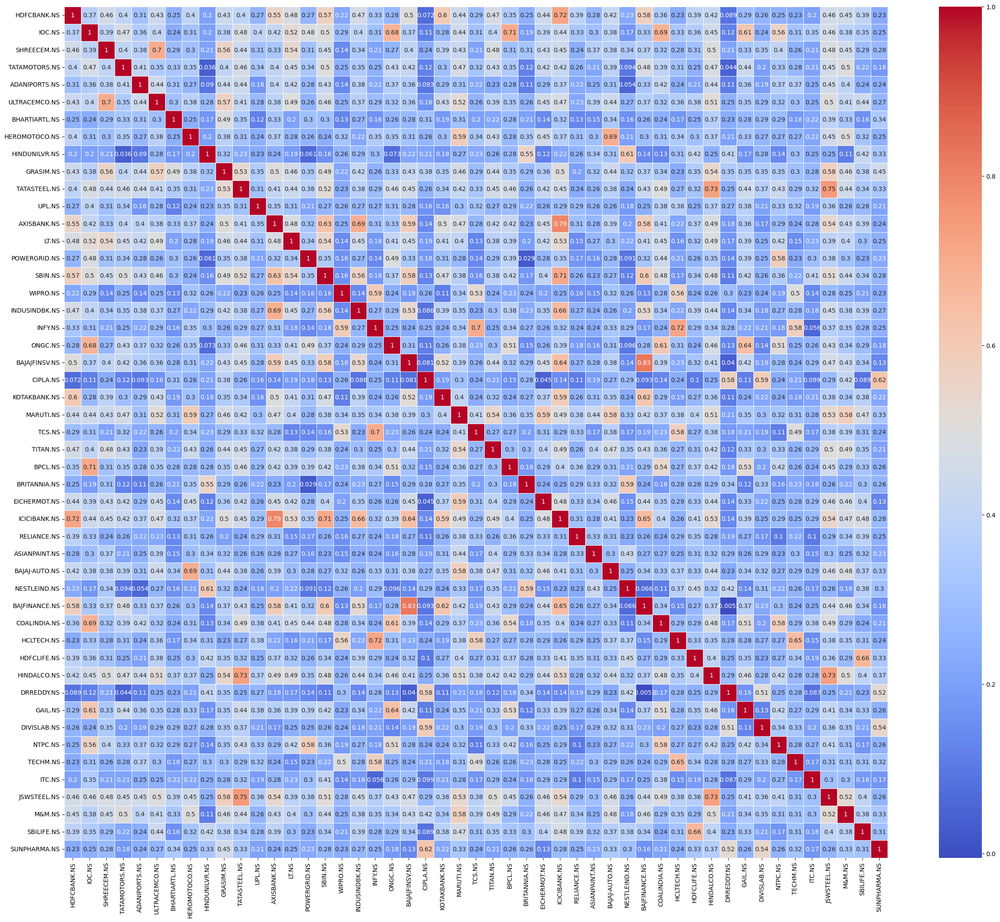

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['UPL.NS', 'WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['HEROMOTOCO.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS', 'SBILIFE.NS']
Cluster 3: ['BHARTIARTL.NS', 'CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 4: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'RELIANCE.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'HDFCLIFE.NS', 'ITC.NS']
Cluster 5: ['SHREECEM.NS', 'TATAMOTORS.NS', 'ADANIPORTS.NS', 'ULTRACEMCO.NS', 'LT.NS']
Cluster 6: ['GRASIM.NS', 'TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 7: ['BAJAJFINSV.NS', 'KOTAKBANK.NS', 'BAJFINANCE.NS']
Cluster 8: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'ICICIBANK.NS']
Cluster 9: ['IOC.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS']
Cluster 10: ['POWERGRID.NS', 'NTPC.NS']
{'HDFCBANK.NS':                                   Open        Close    Returns
Date                                                          
2020-04-03 00:00:00+05:30   809.261901   781.


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2021-04-02 to 2022-04-02 Return: 20.72%
NIFTY 500 from 2021-04-02 to 2022-04-02 Return: 22.67%
SENSEX from 2021-04-02 to 2022-04-02 Return: 20.58%
{'HCLTECH.NS':                                   Open        Close   Returns
Date                                                         
2021-04-05 00:00:00+05:30   872.099334   895.049316  0.000000
2021-04-06 00:00:00+05:30   899.812479   890.632507 -0.493471
2021-04-07 00:00:00+05:30   892.884092   898.253479  0.855681
2021-04-08 00:00:00+05:30   904.142668   898.513428  0.028939
2021-04-09 00:00:00+05:30   902.497077   905.355042  0.761437
...                                ...          ...       ...
2022-03-28 00:00:00+05:30  1061.039281  1042.279175 -1.305778
2022-03-29 00:00:00+05:30  1045.010302  1045.637085  0.322170
2022-03-30 00:00:00+05:30  1054.278264  1043.398315 -0.214106
2022-03-31 00:00:00+05:30  1051.994809  1042.099854 -0.124445
2022-04-01 00:00:00+05:30  1039.637487  1047.383301  0.507000

[248 rows x 3 col

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


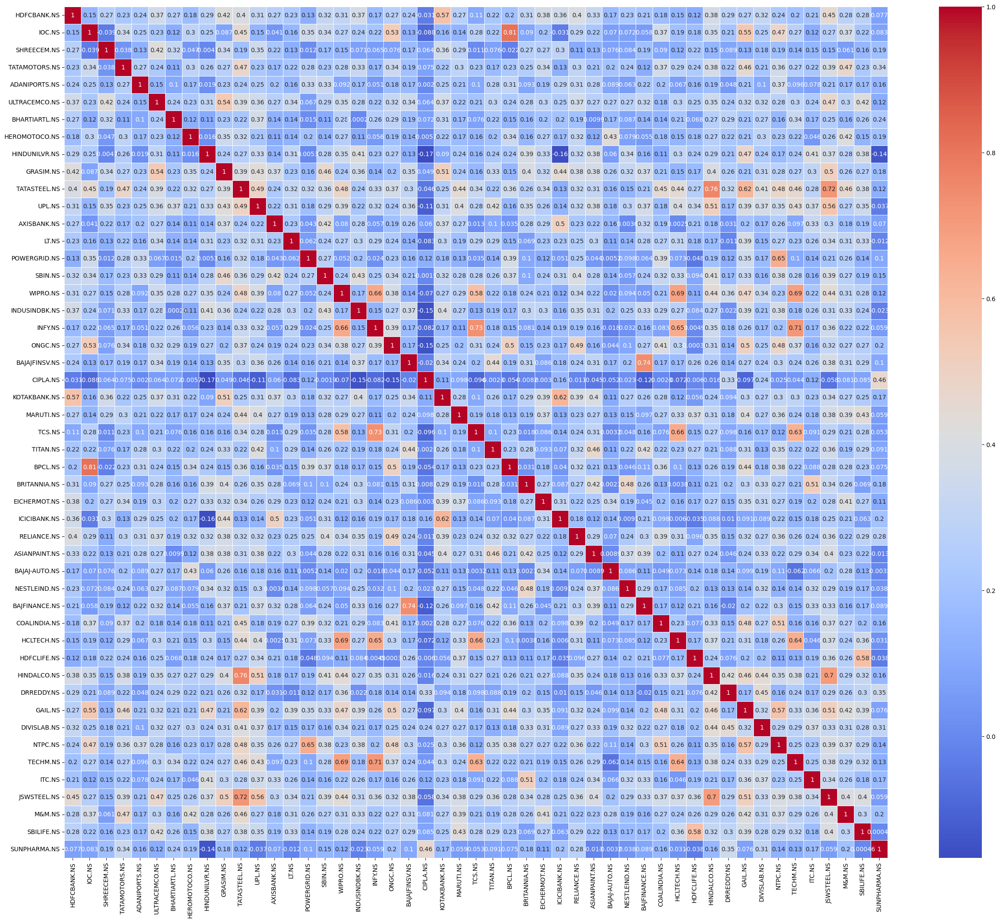

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['HDFCBANK.NS', 'SHREECEM.NS', 'GRASIM.NS', 'AXISBANK.NS', 'KOTAKBANK.NS', 'EICHERMOT.NS', 'ICICIBANK.NS']
Cluster 3: ['ULTRACEMCO.NS', 'HINDUNILVR.NS', 'LT.NS', 'INDUSINDBK.NS', 'MARUTI.NS', 'M&M.NS', 'SBILIFE.NS']
Cluster 4: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'UPL.NS', 'HINDALCO.NS', 'GAIL.NS', 'JSWSTEEL.NS']
Cluster 5: ['BHARTIARTL.NS', 'CIPLA.NS', 'DRREDDY.NS', 'SUNPHARMA.NS']
Cluster 6: ['ADANIPORTS.NS', 'HEROMOTOCO.NS', 'POWERGRID.NS', 'BAJAJ-AUTO.NS', 'HDFCLIFE.NS']
Cluster 7: ['BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'DIVISLAB.NS', 'ITC.NS']
Cluster 8: ['BAJAJFINSV.NS', 'TITAN.NS', 'BAJFINANCE.NS']
Cluster 9: ['IOC.NS', 'BPCL.NS']
Cluster 10: ['SBIN.NS', 'ONGC.NS', 'RELIANCE.NS', 'COALINDIA.NS', 'NTPC.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2023-08-14 00:00:00+05:30  1589.297481  1589.19


[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-02-11 to 2024-08-11 Return: 12.73%
NIFTY 500 from 2024-02-11 to 2024-08-11 Return: 16.51%
SENSEX from 2024-02-11 to 2024-08-11 Return: 12.15%
{'HCLTECH.NS':                                   Open        Close   Returns
Date                                                         
2024-02-12 00:00:00+05:30  1604.982447  1632.352295  0.000000
2024-02-13 00:00:00+05:30  1640.235322  1631.030396 -0.080981
2024-02-14 00:00:00+05:30  1615.509285  1636.807861  0.354222
2024-02-15 00:00:00+05:30  1643.173111  1628.043823 -0.535435
2024-02-16 00:00:00+05:30  1640.235266  1632.841919  0.294715
...                                ...          ...       ...
2024-08-05 00:00:00+05:30  1575.000000  1562.400024 -2.914312
2024-08-06 00:00:00+05:30  1563.000000  1582.750000  1.302482
2024-08-07 00:00:00+05:30  1605.000000  1594.599976  0.748695
2024-08-08 00:00:00+05:30  1597.000000  1557.849976 -2.304653
2024-08-09 00:00:00+05:30  1584.900024  1589.949951  2.060531

[121 rows x 3 col

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


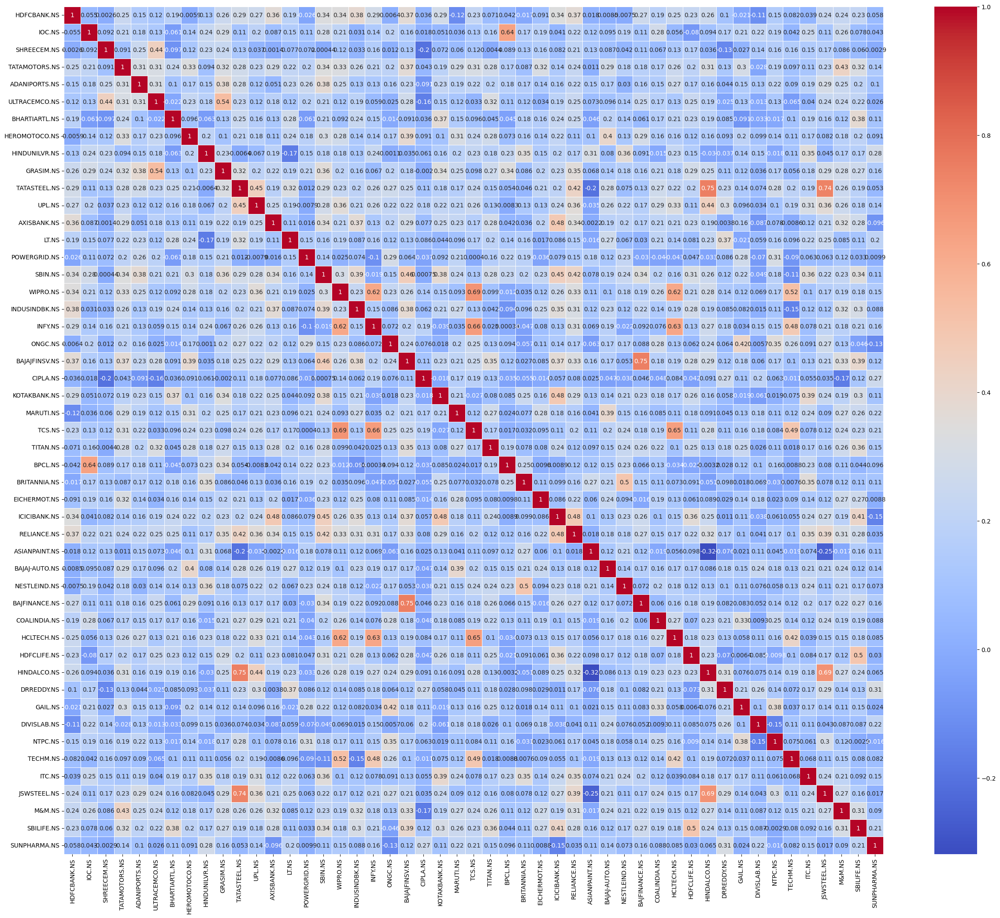

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS']
Cluster 2: ['TATASTEEL.NS', 'UPL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 3: ['TATAMOTORS.NS', 'ADANIPORTS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'M&M.NS']
Cluster 4: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 5: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'ICICIBANK.NS', 'RELIANCE.NS', 'BAJFINANCE.NS']
Cluster 6: ['BHARTIARTL.NS', 'KOTAKBANK.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 7: ['POWERGRID.NS', 'ONGC.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 8: ['HEROMOTOCO.NS', 'LT.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'TECHM.NS']
Cluster 9: ['SHREECEM.NS', 'HINDUNILVR.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'ITC.NS']
Cluster 10: ['IOC.NS', 'BPCL.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2023-02-13 00:00:00+05:30  1614.193317  1617.46


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2023-08-13 to 2024-02-11 Return: 12.08%
NIFTY 500 from 2023-08-13 to 2024-02-11 Return: 18.64%
SENSEX from 2023-08-13 to 2024-02-11 Return: 9.47%
{'HCLTECH.NS':                                   Open        Close   Returns
Date                                                         
2023-08-14 00:00:00+05:30  1126.806198  1127.143066  0.000000
2023-08-16 00:00:00+05:30  1131.715276  1133.062866  0.525204
2023-08-17 00:00:00+05:30  1132.774044  1132.629639 -0.038235
2023-08-18 00:00:00+05:30  1129.068329  1129.742065 -0.254944
2023-08-21 00:00:00+05:30  1129.020132  1135.084229  0.472866
...                                ...          ...       ...
2024-02-05 00:00:00+05:30  1552.054230  1523.068604 -1.793219
2024-02-06 00:00:00+05:30  1533.497556  1590.048950  4.397724
2024-02-07 00:00:00+05:30  1594.210837  1581.823364 -0.517317
2024-02-08 00:00:00+05:30  1592.252344  1599.890503  1.142172
2024-02-09 00:00:00+05:30  1605.961640  1596.756714 -0.195875

[121 rows x 3 colu

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


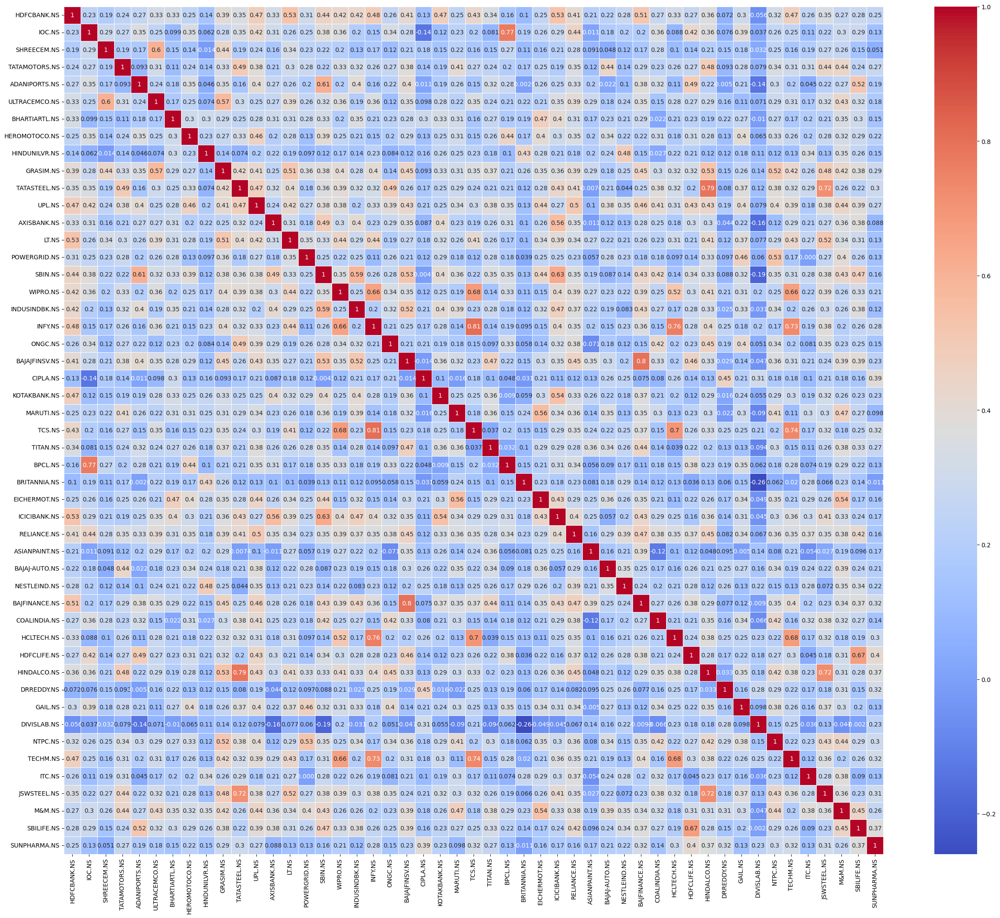

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['IOC.NS', 'HEROMOTOCO.NS', 'UPL.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 2: ['ADANIPORTS.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 3: ['INFY.NS', 'TCS.NS', 'HCLTECH.NS']
Cluster 4: ['BHARTIARTL.NS', 'MARUTI.NS', 'EICHERMOT.NS', 'M&M.NS']
Cluster 5: ['SHREECEM.NS', 'CIPLA.NS', 'ASIANPAINT.NS', 'BAJAJ-AUTO.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 6: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'NESTLEIND.NS', 'ITC.NS']
Cluster 7: ['BAJAJFINSV.NS', 'TITAN.NS', 'RELIANCE.NS', 'BAJFINANCE.NS']
Cluster 8: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS']
Cluster 9: ['ULTRACEMCO.NS', 'GRASIM.NS', 'LT.NS', 'WIPRO.NS', 'TECHM.NS']
Cluster 10: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2022-08-16 00:00:00+05:30  1457.943311  1465.11


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2023-02-12 to 2023-08-13 Return: 9.33%
NIFTY 500 from 2023-02-12 to 2023-08-13 Return: 13.15%
SENSEX from 2023-02-12 to 2023-08-13 Return: 8.09%
{'ONGC.NS':                                  Open       Close   Returns
Date                                                       
2023-02-13 00:00:00+05:30  137.063469  137.714157  0.000000
2023-02-14 00:00:00+05:30  138.178936  137.993027  0.202499
2023-02-15 00:00:00+05:30  138.504293  137.109955 -0.639940
2023-02-16 00:00:00+05:30  139.433836  144.918228  5.694899
2023-02-17 00:00:00+05:30  144.546434  145.568954  0.449030
...                               ...         ...       ...
2023-08-07 00:00:00+05:30  166.324088  165.035858 -0.230749
2023-08-08 00:00:00+05:30  164.988137  165.417557  0.231282
2023-08-09 00:00:00+05:30  165.417558  168.805099  2.047874
2023-08-10 00:00:00+05:30  169.950186  170.475006  0.989251
2023-08-11 00:00:00+05:30  170.713575  169.091370 -0.811636

[123 rows x 3 columns]}
Portfolio average from 2

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


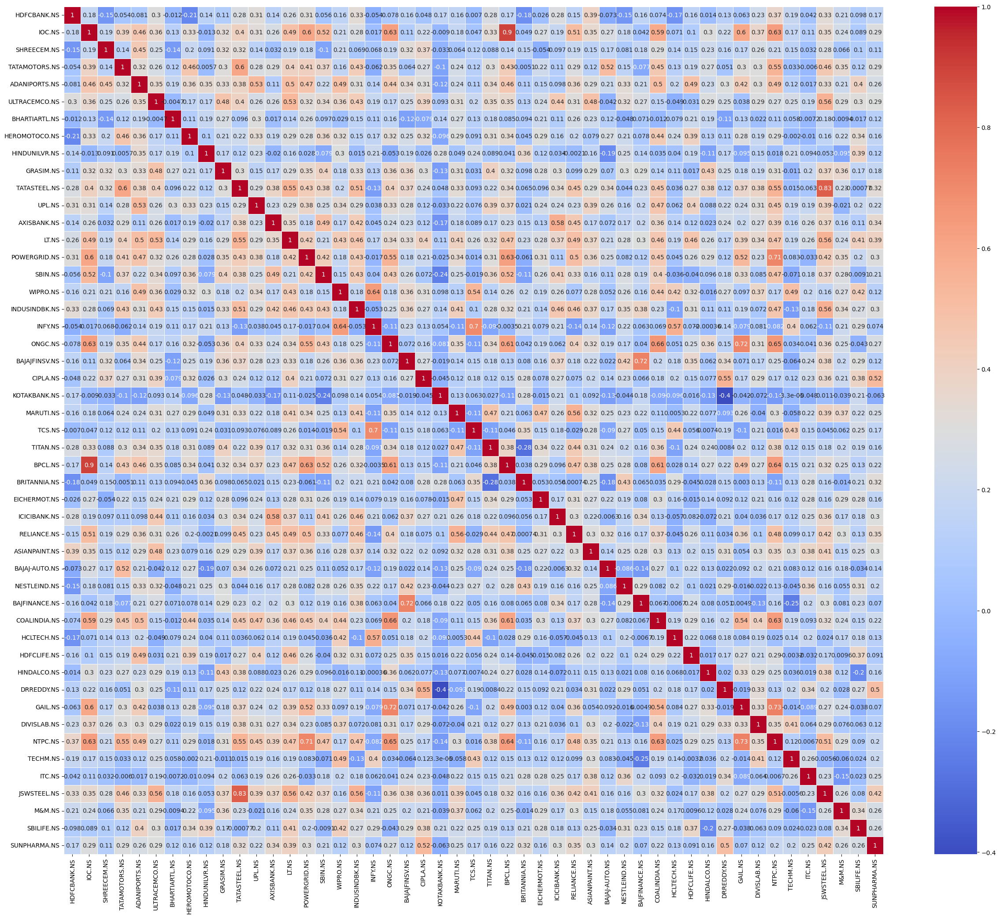

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['BAJAJ-AUTO.NS', 'HINDALCO.NS', 'DIVISLAB.NS']
Cluster 2: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'LT.NS', 'RELIANCE.NS', 'JSWSTEEL.NS']
Cluster 3: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 4: ['SHREECEM.NS', 'CIPLA.NS', 'BRITANNIA.NS', 'NESTLEIND.NS', 'DRREDDY.NS', 'ITC.NS', 'SBILIFE.NS', 'SUNPHARMA.NS']
Cluster 5: ['HEROMOTOCO.NS', 'UPL.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS']
Cluster 6: ['ULTRACEMCO.NS', 'GRASIM.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'ASIANPAINT.NS', 'M&M.NS']
Cluster 7: ['BAJAJFINSV.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 8: ['HDFCBANK.NS', 'BHARTIARTL.NS', 'HINDUNILVR.NS', 'KOTAKBANK.NS', 'HDFCLIFE.NS']
Cluster 9: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 10: ['ADANIPORTS.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2024-02-12 00:00:00+05:30  1380.794683  1371.27


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-05-12 to 2024-08-11 Return: 10.24%
NIFTY 500 from 2024-05-12 to 2024-08-11 Return: 11.76%
SENSEX from 2024-05-12 to 2024-08-11 Return: 9.52%
{'BAJAJ-AUTO.NS':                                   Open        Close   Returns
Date                                                         
2024-05-13 00:00:00+05:30  8950.159554  8919.805664  0.000000
2024-05-14 00:00:00+05:30  8880.078950  8992.167969  0.811254
2024-05-15 00:00:00+05:30  8995.887564  8831.375000 -1.788145
2024-05-16 00:00:00+05:30  8877.847512  8800.327148 -0.351563
2024-05-17 00:00:00+05:30  8819.322701  8709.912109 -1.027405
...                                ...          ...       ...
2024-08-05 00:00:00+05:30  9396.200195  9485.049805 -1.363848
2024-08-06 00:00:00+05:30  9515.250000  9427.400391 -0.607792
2024-08-07 00:00:00+05:30  9570.000000  9708.200195  2.978550
2024-08-08 00:00:00+05:30  9735.000000  9641.299805 -0.689112
2024-08-09 00:00:00+05:30  9761.000000  9765.950195  1.292880

[62 rows x 3 co

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


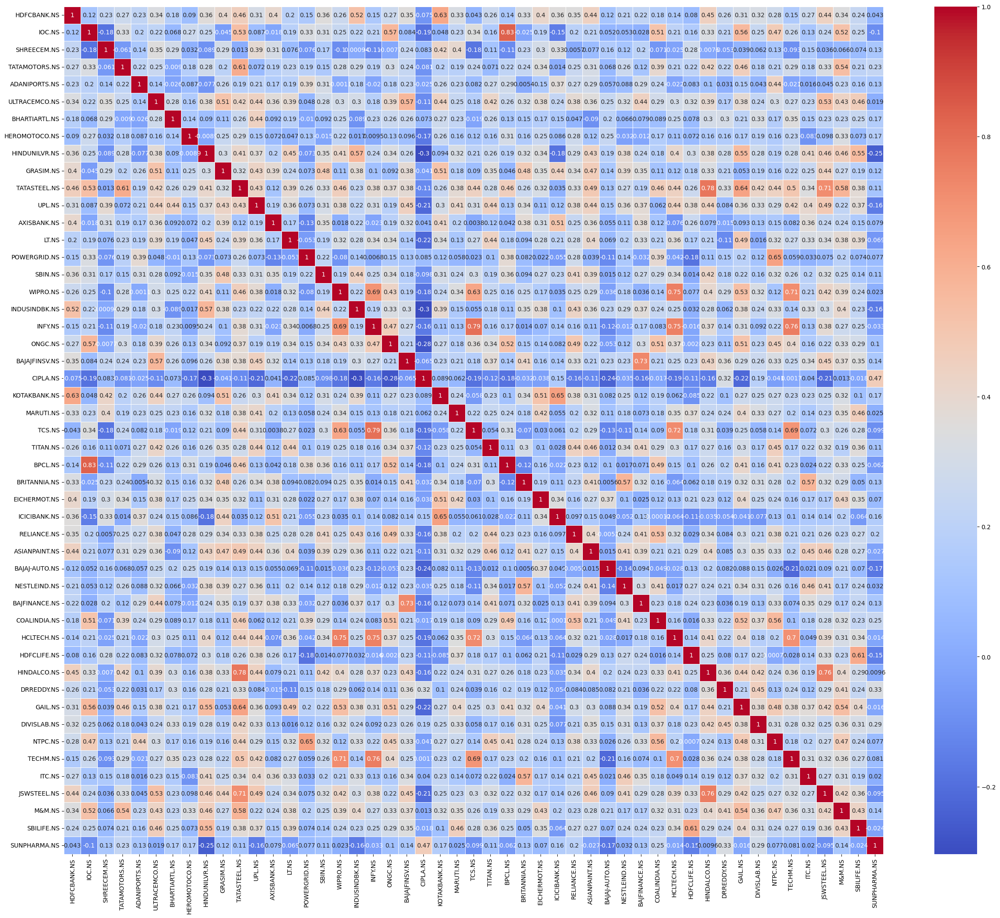

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['ULTRACEMCO.NS', 'UPL.NS', 'BAJAJFINSV.NS', 'TITAN.NS', 'RELIANCE.NS', 'BAJFINANCE.NS']
Cluster 3: ['POWERGRID.NS', 'CIPLA.NS', 'DRREDDY.NS', 'SUNPHARMA.NS']
Cluster 4: ['MARUTI.NS', 'DIVISLAB.NS', 'SBILIFE.NS']
Cluster 5: ['BHARTIARTL.NS', 'HEROMOTOCO.NS', 'BAJAJ-AUTO.NS', 'HDFCLIFE.NS']
Cluster 6: ['SHREECEM.NS', 'ADANIPORTS.NS', 'GRASIM.NS', 'AXISBANK.NS', 'KOTAKBANK.NS', 'BRITANNIA.NS', 'EICHERMOT.NS', 'ICICIBANK.NS']
Cluster 7: ['HINDUNILVR.NS', 'LT.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'ITC.NS']
Cluster 8: ['HDFCBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 9: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'GAIL.NS', 'M&M.NS']
Cluster 10: ['IOC.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'NTPC.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2023-11-13 00:00:00+05:30  1471.999124  1468.74


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-02-11 to 2024-05-12 Return: 2.03%
NIFTY 500 from 2024-02-11 to 2024-05-12 Return: 4.04%
SENSEX from 2024-02-11 to 2024-05-12 Return: 2.24%
{'HCLTECH.NS':                                   Open        Close   Returns
Date                                                         
2024-02-12 00:00:00+05:30  1604.982567  1632.352417  0.000000
2024-02-13 00:00:00+05:30  1640.235322  1631.030396 -0.080989
2024-02-14 00:00:00+05:30  1615.509405  1636.807983  0.354229
2024-02-15 00:00:00+05:30  1643.172987  1628.043701 -0.535450
2024-02-16 00:00:00+05:30  1640.235266  1632.841919  0.294723
2024-02-19 00:00:00+05:30  1635.339067  1640.480103  0.467785
2024-02-20 00:00:00+05:30  1626.525947  1628.533447 -0.728241
2024-02-21 00:00:00+05:30  1621.188966  1602.338501 -1.608499
2024-02-22 00:00:00+05:30  1609.878673  1651.398682  3.061786
2024-02-23 00:00:00+05:30  1661.778650  1631.177246 -1.224504
2024-02-26 00:00:00+05:30  1631.177382  1615.558472 -0.957515
2024-02-27 00:00:00+0

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


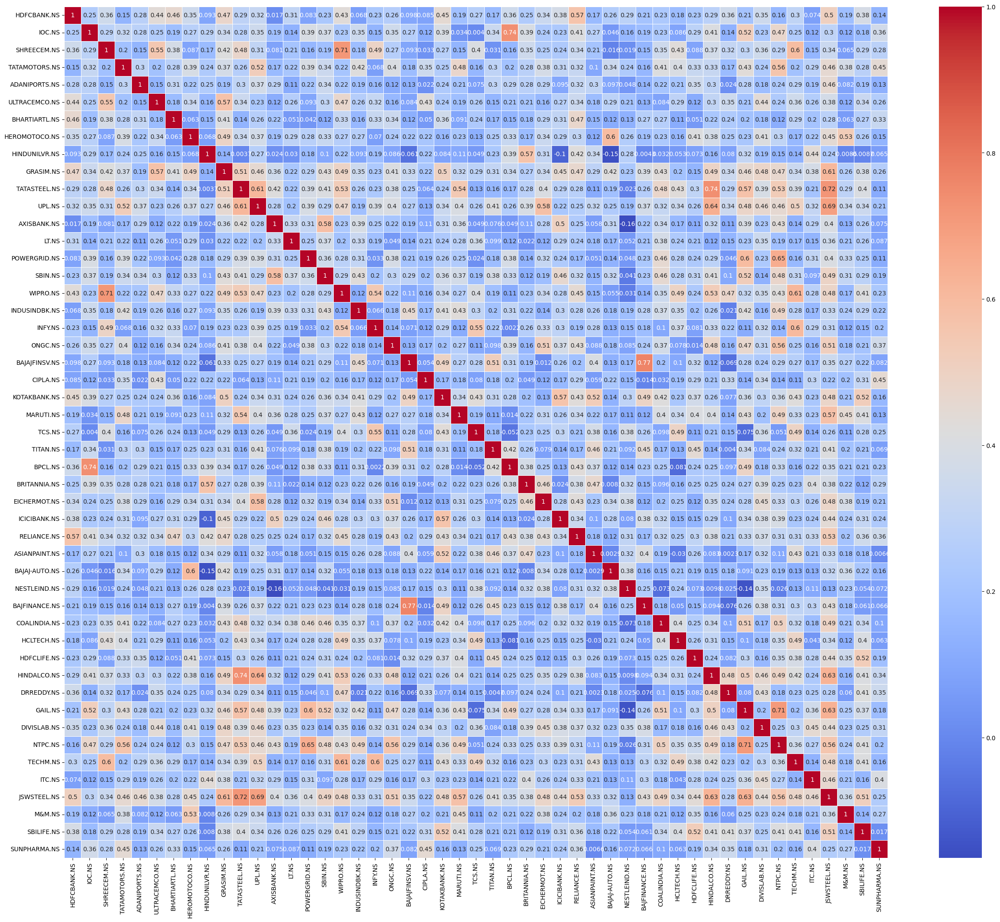

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['HEROMOTOCO.NS', 'LT.NS', 'BAJAJ-AUTO.NS', 'NESTLEIND.NS', 'M&M.NS']
Cluster 2: ['SHREECEM.NS', 'WIPRO.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 3: ['IOC.NS', 'TATAMOTORS.NS', 'POWERGRID.NS', 'ONGC.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 4: ['AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS']
Cluster 5: ['HDFCBANK.NS', 'BHARTIARTL.NS', 'INFY.NS', 'TCS.NS']
Cluster 6: ['ULTRACEMCO.NS', 'CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'ITC.NS', 'SUNPHARMA.NS']
Cluster 7: ['BAJAJFINSV.NS', 'TITAN.NS', 'BAJFINANCE.NS', 'HDFCLIFE.NS']
Cluster 8: ['ADANIPORTS.NS', 'HINDUNILVR.NS', 'BPCL.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS']
Cluster 9: ['GRASIM.NS', 'TATASTEEL.NS', 'UPL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 10: ['MARUTI.NS', 'EICHERMOT.NS', 'RELIANCE.NS', 'SBILIFE.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2023-08-14 00:00:00+05:30  1589.297481  1589.19


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2023-11-12 to 2024-02-11 Return: 12.03%
NIFTY 500 from 2023-11-12 to 2024-02-11 Return: 15.26%
SENSEX from 2023-11-12 to 2024-02-11 Return: 10.26%
{'BAJAJ-AUTO.NS':                                   Open        Close   Returns
Date                                                         
2023-11-13 00:00:00+05:30  5391.184180  5381.463379  0.000000
2023-11-15 00:00:00+05:30  5480.458582  5492.064453  2.055223
2023-11-16 00:00:00+05:30  5475.499107  5506.149902  0.256469
2023-11-17 00:00:00+05:30  5512.101409  5586.100098  1.452016
2023-11-20 00:00:00+05:30  5564.822790  5604.599609  0.331170
2023-11-21 00:00:00+05:30  5595.027542  5640.111328  0.633617
2023-11-22 00:00:00+05:30  5634.209142  5705.182129  1.153715
2023-11-23 00:00:00+05:30  5753.241672  5877.481934  3.020058
2023-11-24 00:00:00+05:30  5892.113206  5882.491211  0.085228
2023-11-28 00:00:00+05:30  5921.672887  5949.794434  1.144128
2023-11-29 00:00:00+05:30  5961.548735  6021.015625  1.197036
2023-11-30 00:0

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


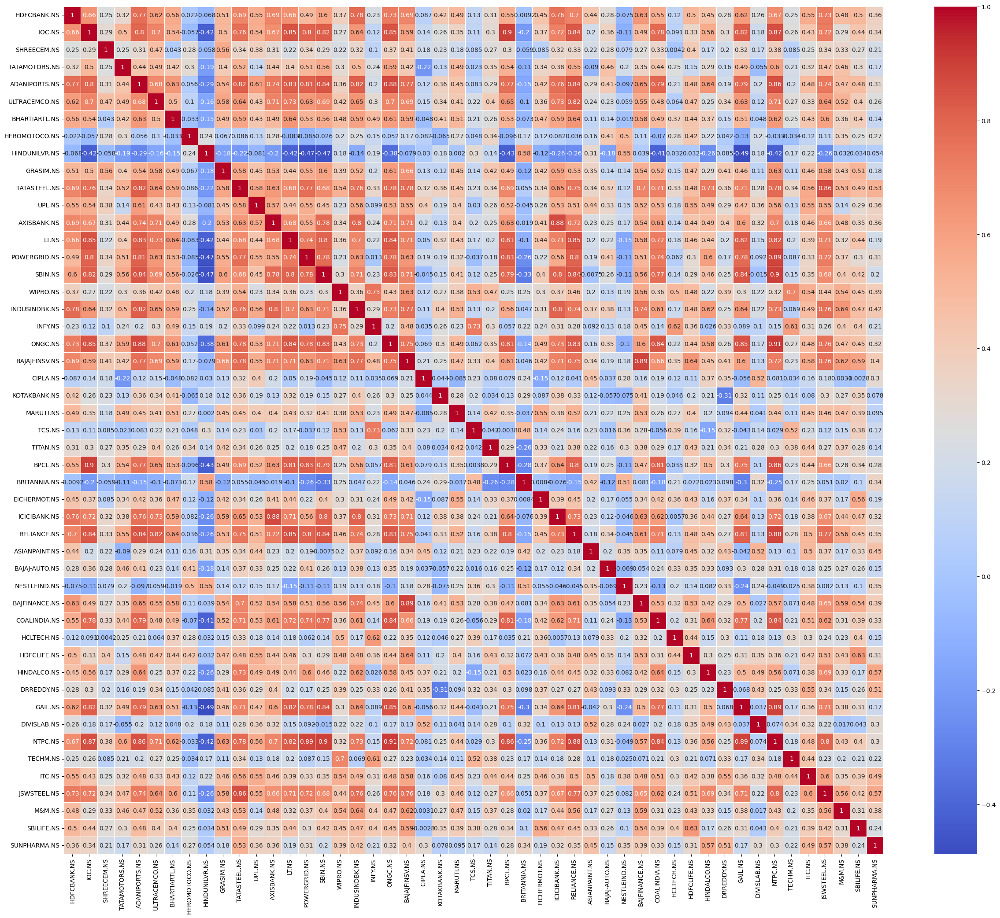

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'KOTAKBANK.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['TATAMOTORS.NS', 'HINDALCO.NS', 'M&M.NS']
Cluster 3: ['SHREECEM.NS', 'HEROMOTOCO.NS', 'TITAN.NS', 'BAJAJ-AUTO.NS']
Cluster 4: ['HINDUNILVR.NS', 'CIPLA.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 5: ['ADANIPORTS.NS', 'LT.NS', 'SBIN.NS', 'ONGC.NS', 'RELIANCE.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 6: ['IOC.NS', 'POWERGRID.NS', 'BPCL.NS', 'COALINDIA.NS']
Cluster 7: ['BHARTIARTL.NS', 'GRASIM.NS', 'UPL.NS', 'MARUTI.NS', 'BAJFINANCE.NS', 'ITC.NS']
Cluster 8: ['EICHERMOT.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 9: ['ULTRACEMCO.NS', 'AXISBANK.NS', 'ICICIBANK.NS']
Cluster 10: ['HDFCBANK.NS', 'TATASTEEL.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'JSWSTEEL.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2024-04-15 00:00:00+05:30  1477.375789  1474.56

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

Portfolio Average From 2024-04-13 to 2024-06-12 Return: 13.35%
2024-06-12 2024-08-11



[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-06-12 to 2024-08-11 Return: 4.48%
NIFTY 500 from 2024-06-12 to 2024-08-11 Return: 4.38%
SENSEX from 2024-06-12 to 2024-08-11 Return: 4.05%
{'TECHM.NS':                                   Open        Close   Returns
Date                                                         
2024-06-12 00:00:00+05:30  1339.975005  1345.669434  0.000000
2024-06-13 00:00:00+05:30  1354.898513  1363.685669  1.338831
2024-06-14 00:00:00+05:30  1369.625715  1346.504028 -1.259941
2024-06-18 00:00:00+05:30  1355.340213  1346.405762 -0.007298
2024-06-19 00:00:00+05:30  1351.953050  1356.027588  0.714630
2024-06-20 00:00:00+05:30  1360.789423  1367.760254  0.865223
2024-06-21 00:00:00+05:30  1382.389177  1374.338379  0.480941
2024-06-24 00:00:00+05:30  1364.716600  1376.203735  0.135728
2024-06-25 00:00:00+05:30  1373.356542  1401.779907  1.858458
2024-06-26 00:00:00+05:30  1406.738170  1387.347412 -1.029584
2024-06-27 00:00:00+05:30  1378.805583  1406.198120  1.358759
2024-06-28 00:00:00+05:

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


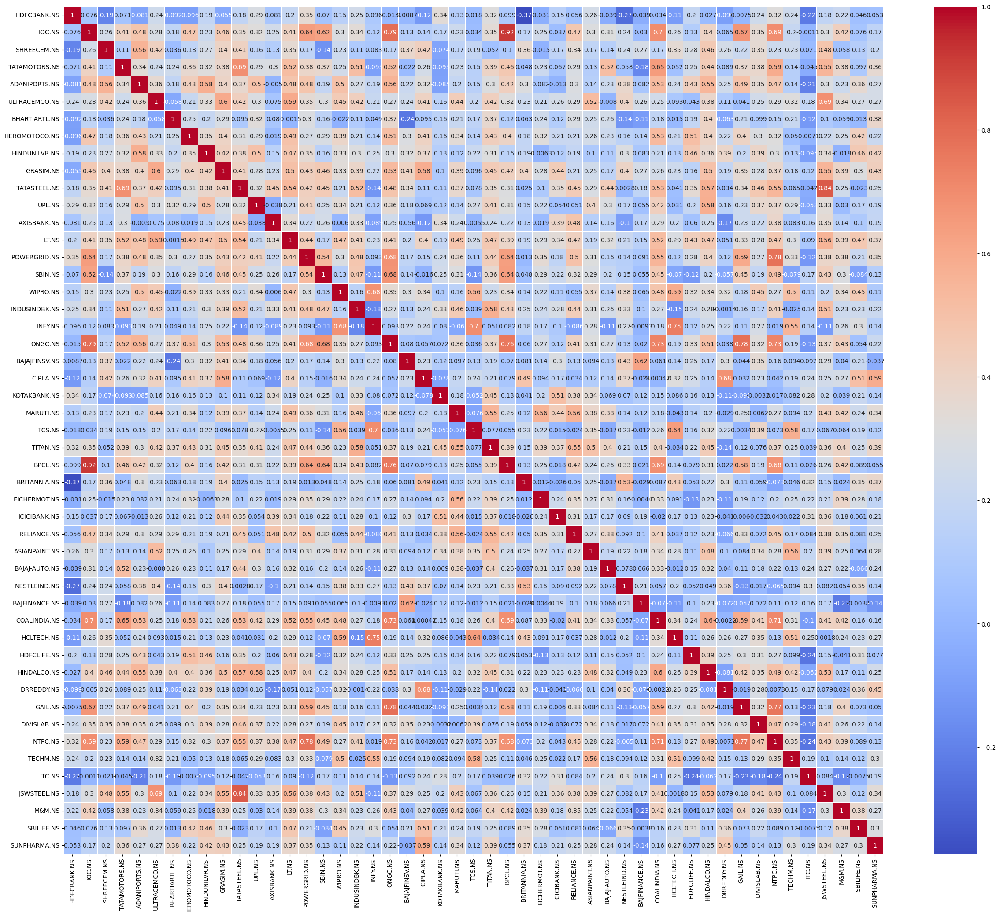

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['SHREECEM.NS', 'HINDUNILVR.NS', 'CIPLA.NS', 'BRITANNIA.NS', 'NESTLEIND.NS', 'DRREDDY.NS', 'SBILIFE.NS', 'SUNPHARMA.NS']
Cluster 2: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 3: ['ADANIPORTS.NS', 'HEROMOTOCO.NS', 'UPL.NS', 'HINDALCO.NS', 'DIVISLAB.NS']
Cluster 4: ['TATAMOTORS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'TATASTEEL.NS', 'LT.NS', 'JSWSTEEL.NS']
Cluster 5: ['INDUSINDBK.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'RELIANCE.NS', 'ASIANPAINT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS']
Cluster 6: ['AXISBANK.NS']
Cluster 7: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 8: ['SBIN.NS']
Cluster 9: ['BAJAJFINSV.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS', 'ITC.NS']
Cluster 10: ['HDFCBANK.NS', 'BHARTIARTL.NS', 'HDFCLIFE.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2024-02-13 00:00:00+05:30  1373.198352  1375.66


[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-04-13 to 2024-06-12 Return: 4.46%
NIFTY 500 from 2024-04-13 to 2024-06-12 Return: 6.71%
SENSEX from 2024-04-13 to 2024-06-12 Return: 4.16%
{'NESTLEIND.NS':                                   Open        Close   Returns
Date                                                         
2024-04-15 00:00:00+05:30  2499.160668  2542.622070  0.000000
2024-04-16 00:00:00+05:30  2539.137052  2535.104736 -0.295653
2024-04-18 00:00:00+05:30  2529.130676  2451.915527 -3.281490
2024-04-19 00:00:00+05:30  2419.506152  2427.172852 -1.009116
2024-04-22 00:00:00+05:30  2425.977951  2448.082031  0.861462
2024-04-23 00:00:00+05:30  2438.424125  2490.448486  1.730598
2024-04-24 00:00:00+05:30  2504.188828  2489.353027 -0.043986
2024-04-25 00:00:00+05:30  2509.067698  2551.583252  2.499855
2024-04-26 00:00:00+05:30  2563.830109  2472.028320 -3.117865
2024-04-29 00:00:00+05:30  2491.195062  2498.961426  1.089514
2024-04-30 00:00:00+05:30  2506.827346  2496.571777 -0.095626
2024-05-02 00:00:00

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


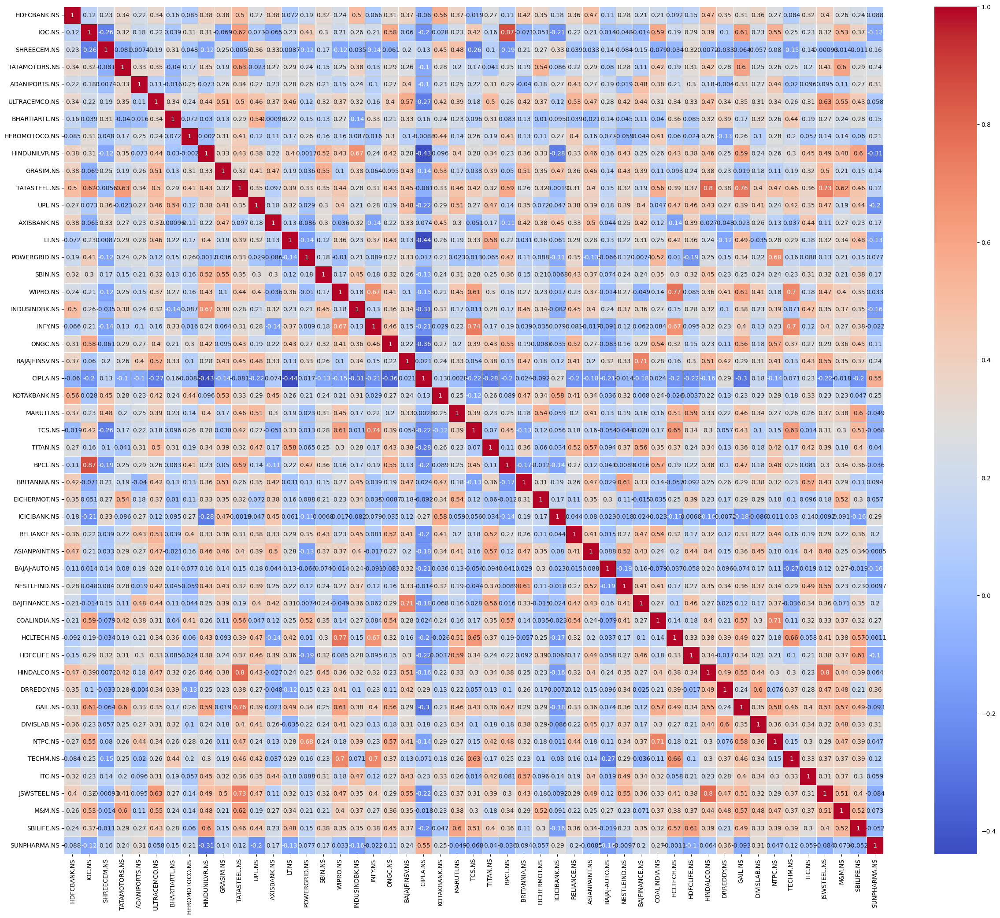

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['MARUTI.NS', 'EICHERMOT.NS', 'HDFCLIFE.NS', 'DRREDDY.NS', 'DIVISLAB.NS']
Cluster 2: ['ULTRACEMCO.NS', 'GRASIM.NS', 'UPL.NS', 'BAJAJFINSV.NS', 'TITAN.NS', 'RELIANCE.NS', 'BAJFINANCE.NS']
Cluster 3: ['SHREECEM.NS', 'AXISBANK.NS', 'CIPLA.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS', 'SUNPHARMA.NS']
Cluster 4: ['BHARTIARTL.NS', 'HEROMOTOCO.NS', 'POWERGRID.NS', 'BAJAJ-AUTO.NS']
Cluster 5: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'GAIL.NS', 'M&M.NS']
Cluster 6: ['IOC.NS', 'ADANIPORTS.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'NTPC.NS']
Cluster 7: ['HDFCBANK.NS', 'HINDUNILVR.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 8: ['BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'ITC.NS']
Cluster 9: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 10: ['LT.NS', 'SBILIFE.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2023-12-15 00:00:00+05:30  1627.772077  1634.23


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2024-02-13 to 2024-04-13 Return: 3.57%
NIFTY 500 from 2024-02-13 to 2024-04-13 Return: 4.87%
SENSEX from 2024-02-13 to 2024-04-13 Return: 3.76%
{'DRREDDY.NS':                                   Open        Close   Returns
Date                                                         
2024-02-13 00:00:00+05:30  6312.618348  6298.054688  0.000000
2024-02-14 00:00:00+05:30  6292.785430  6221.507812 -1.215405
2024-02-15 00:00:00+05:30  6203.365383  6215.841309 -0.091079
2024-02-16 00:00:00+05:30  6235.027805  6279.961426  1.031560
2024-02-19 00:00:00+05:30  6279.961252  6379.372559  1.582990
2024-02-20 00:00:00+05:30  6384.194044  6338.464844 -0.641250
2024-02-21 00:00:00+05:30  6349.400226  6311.772949 -0.421110
2024-02-22 00:00:00+05:30  6337.471084  6326.486328  0.233110
2024-02-23 00:00:00+05:30  6330.214157  6404.225586  1.228790
2024-02-26 00:00:00+05:30  6407.108477  6402.833984 -0.021729
2024-02-27 00:00:00+05:30  6378.229539  6411.631836  0.137406
2024-02-28 00:00:00+0

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


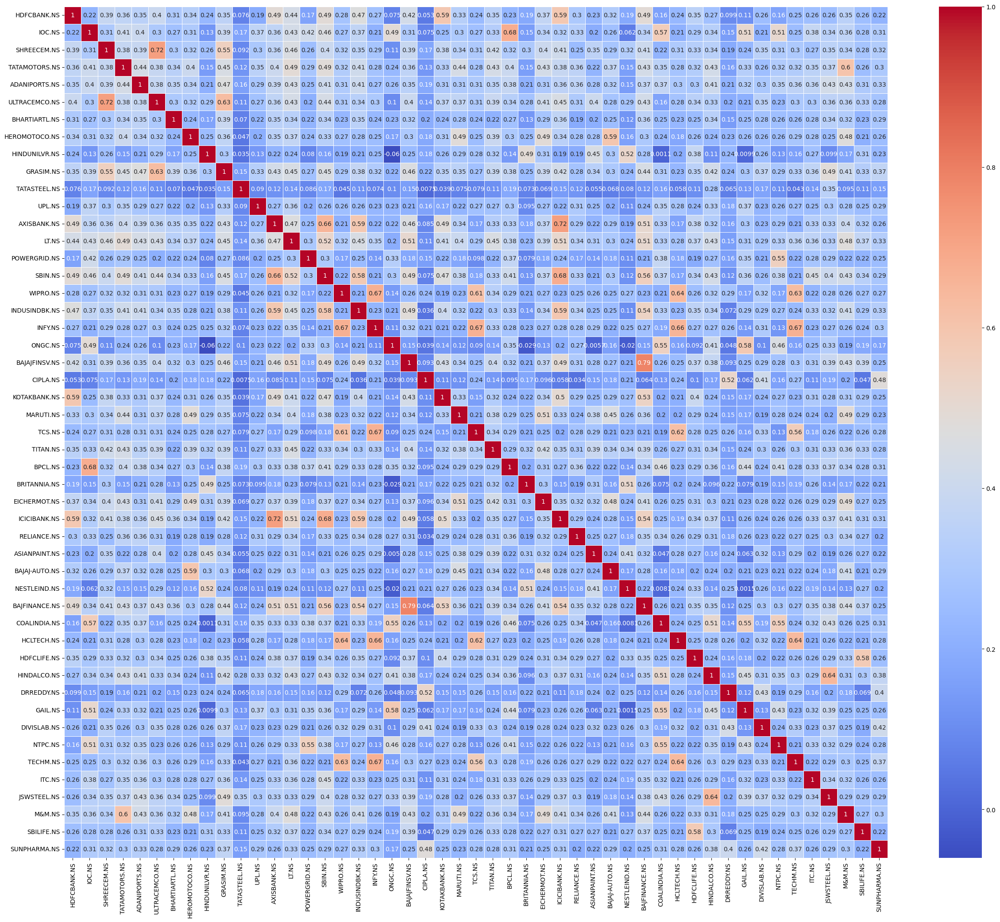

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['SHREECEM.NS', 'ADANIPORTS.NS', 'ULTRACEMCO.NS', 'BHARTIARTL.NS', 'GRASIM.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 2: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 3: ['UPL.NS', 'HINDALCO.NS', 'ITC.NS', 'JSWSTEEL.NS']
Cluster 4: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 5: ['LT.NS', 'BAJAJFINSV.NS', 'KOTAKBANK.NS', 'BAJFINANCE.NS']
Cluster 6: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'ICICIBANK.NS']
Cluster 7: ['TATASTEEL.NS', 'CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 8: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS']
Cluster 9: ['TATAMOTORS.NS', 'HEROMOTOCO.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS']
Cluster 10: ['RELIANCE.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2020-08-12 00:00:00+05:30  1022.377292  1021.12


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2022-08-12 to 2024-08-11 Return: 37.68%
NIFTY 500 from 2022-08-12 to 2024-08-11 Return: 51.40%
SENSEX from 2022-08-12 to 2024-08-11 Return: 34.04%
{'GRASIM.NS':                                   Open        Close   Returns
Date                                                         
2022-08-12 00:00:00+05:30  1586.881940  1601.190552  0.000000
2022-08-16 00:00:00+05:30  1609.973017  1570.550171 -1.913600
2022-08-17 00:00:00+05:30  1578.888664  1595.220337  1.570798
2022-08-18 00:00:00+05:30  1586.783198  1592.457275 -0.173209
2022-08-19 00:00:00+05:30  1598.575487  1584.661499 -0.489544
...                                ...          ...       ...
2024-08-05 00:00:00+05:30  2644.985676  2602.250000 -3.493061
2024-08-06 00:00:00+05:30  2627.000000  2620.500000  0.701316
2024-08-07 00:00:00+05:30  2650.000000  2637.050049  0.631561
2024-08-08 00:00:00+05:30  2623.250000  2544.649902 -3.503921
2024-08-09 00:00:00+05:30  2556.100098  2572.750000  1.104281

[490 rows x 3 colu

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


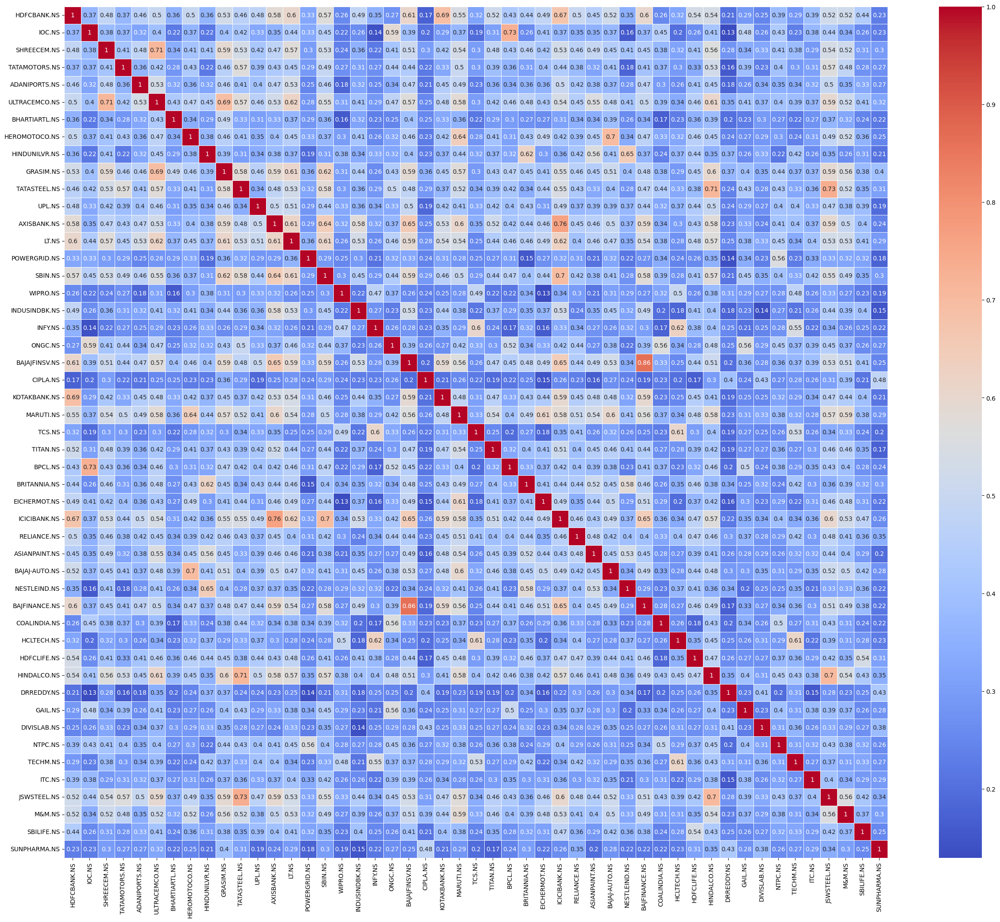

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['HDFCBANK.NS', 'AXISBANK.NS', 'LT.NS', 'SBIN.NS', 'BAJAJFINSV.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 2: ['TATAMOTORS.NS', 'ADANIPORTS.NS', 'UPL.NS', 'BPCL.NS', 'RELIANCE.NS']
Cluster 3: ['BHARTIARTL.NS', 'CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SBILIFE.NS', 'SUNPHARMA.NS']
Cluster 4: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS', 'ITC.NS']
Cluster 5: ['INDUSINDBK.NS', 'KOTAKBANK.NS', 'TITAN.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'HDFCLIFE.NS']
Cluster 6: ['HEROMOTOCO.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS']
Cluster 7: ['TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 8: ['SHREECEM.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'MARUTI.NS', 'M&M.NS']
Cluster 9: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 10: ['HINDUNILVR.NS', 'NESTLEIND.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2018-08-13 00:00:00+05:30   991.911282   995.55


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2020-08-12 to 2022-08-12 Return: 56.16%
NIFTY 500 from 2020-08-12 to 2022-08-12 Return: 62.58%
SENSEX from 2020-08-12 to 2022-08-12 Return: 54.63%
{'BAJFINANCE.NS':                                   Open        Close   Returns
Date                                                         
2020-08-12 00:00:00+05:30  3375.706563  3369.053711  0.000000
2020-08-13 00:00:00+05:30  3400.346640  3370.433350  0.040950
2020-08-14 00:00:00+05:30  3375.706427  3283.157959 -2.589441
2020-08-17 00:00:00+05:30  3301.786007  3336.085205  1.612083
2020-08-18 00:00:00+05:30  3350.081068  3370.680176  1.036993
...                                ...          ...       ...
2022-08-04 00:00:00+05:30  7271.393843  7249.298828  0.278217
2022-08-05 00:00:00+05:30  7272.384992  7237.459473 -0.163317
2022-08-08 00:00:00+05:30  7232.802521  7274.614258  0.513368
2022-08-10 00:00:00+05:30  7301.167521  7083.588867 -2.625918
2022-08-11 00:00:00+05:30  7177.317858  7251.578125  2.371527

[499 rows x 3 

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


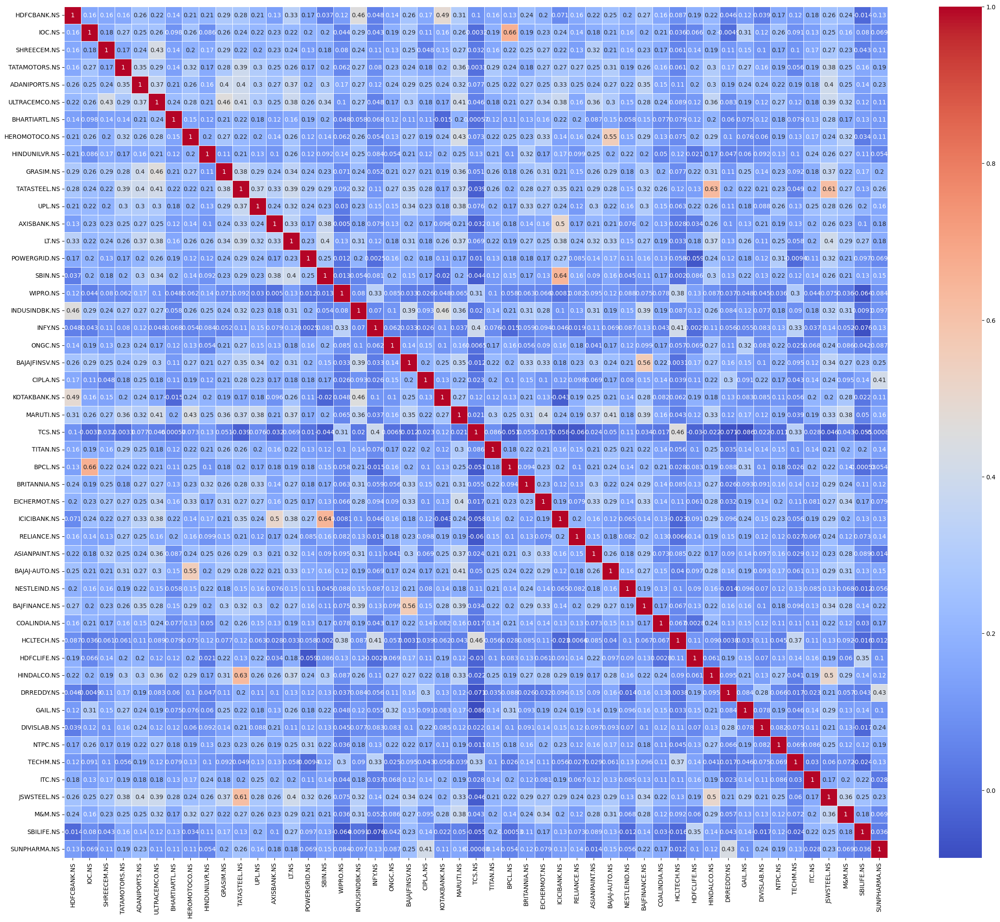

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 3: ['BHARTIARTL.NS', 'HDFCLIFE.NS', 'ITC.NS', 'SBILIFE.NS']
Cluster 4: ['HDFCBANK.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'KOTAKBANK.NS', 'BAJFINANCE.NS']
Cluster 5: ['AXISBANK.NS', 'SBIN.NS', 'ICICIBANK.NS']
Cluster 6: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'RELIANCE.NS', 'NESTLEIND.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 7: ['SHREECEM.NS', 'HINDUNILVR.NS', 'TITAN.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS']
Cluster 8: ['HEROMOTOCO.NS', 'MARUTI.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS']
Cluster 9: ['TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 10: ['TATAMOTORS.NS', 'ADANIPORTS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'UPL.NS', 'LT.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2016-08-16 00:00:00+05:30   579.291247   576.61


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2018-08-13 to 2020-08-12 Return: -0.29%
NIFTY 500 from 2018-08-13 to 2020-08-12 Return: -3.79%
SENSEX from 2018-08-13 to 2020-08-12 Return: 2.02%
{'TCS.NS':                                   Open        Close   Returns
Date                                                         
2018-08-13 00:00:00+05:30  1763.485825  1765.560181  0.000000
2018-08-14 00:00:00+05:30  1758.366135  1768.561523  0.169994
2018-08-16 00:00:00+05:30  1765.692940  1772.931152  0.247072
2018-08-17 00:00:00+05:30  1777.653092  1776.682129  0.211569
2018-08-20 00:00:00+05:30  1786.612989  1774.210815 -0.139097
...                                ...          ...       ...
2020-08-05 00:00:00+05:30  2095.334175  2094.870605  0.435624
2020-08-06 00:00:00+05:30  2109.241054  2139.929443  2.150913
2020-08-07 00:00:00+05:30  2139.836370  2128.108154 -0.552415
2020-08-10 00:00:00+05:30  2149.107899  2116.472656 -0.546753
2020-08-11 00:00:00+05:30  2116.657912  2113.783691 -0.127049

[487 rows x 3 columns]

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


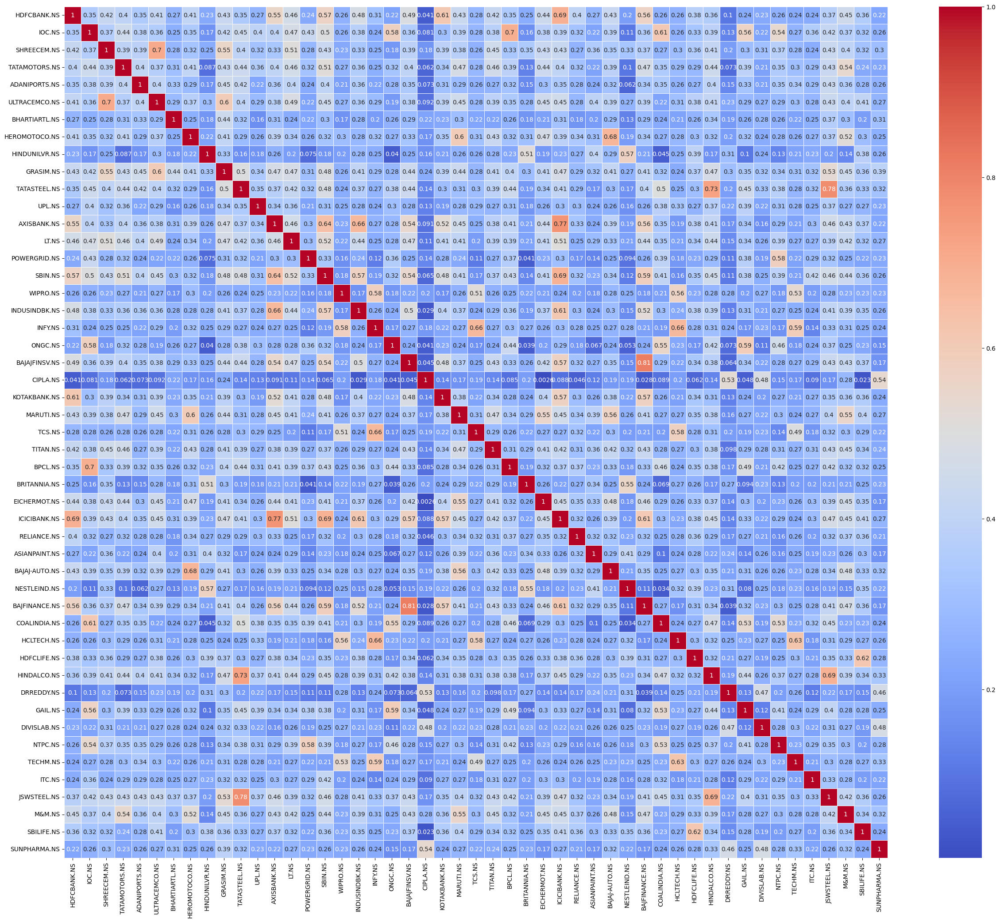

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['ADANIPORTS.NS', 'BHARTIARTL.NS', 'TATASTEEL.NS', 'HINDALCO.NS', 'ITC.NS', 'JSWSTEEL.NS']
Cluster 2: ['RELIANCE.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 3: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 4: ['HINDUNILVR.NS', 'CIPLA.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'NESTLEIND.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 5: ['TATAMOTORS.NS', 'HEROMOTOCO.NS', 'MARUTI.NS', 'TITAN.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'M&M.NS']
Cluster 6: ['SHREECEM.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'LT.NS']
Cluster 7: ['BAJAJFINSV.NS', 'BAJFINANCE.NS']
Cluster 8: ['HDFCBANK.NS', 'AXISBANK.NS', 'SBIN.NS', 'INDUSINDBK.NS', 'KOTAKBANK.NS', 'ICICIBANK.NS']
Cluster 9: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 10: ['UPL.NS']
{'HDFCBANK.NS':                                   Open        Close    Returns
Date                                                          
2020-04-03 00:00:00+05:30   809.261964   781.


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2022-04-02 to 2024-04-01 Return: 23.67%
NIFTY 500 from 2022-04-02 to 2024-04-01 Return: 31.66%
SENSEX from 2022-04-02 to 2024-04-01 Return: 21.51%
{'HINDALCO.NS':                                  Open       Close   Returns
Date                                                       
2022-04-04 00:00:00+05:30  559.914468  575.086975  0.000000
2022-04-05 00:00:00+05:30  578.464154  574.450745 -0.110632
2022-04-06 00:00:00+05:30  570.633210  568.969116 -0.954238
2022-04-07 00:00:00+05:30  569.115904  562.606384 -1.118291
2022-04-08 00:00:00+05:30  567.158172  569.458496  1.217923
...                               ...         ...       ...
2024-03-21 00:00:00+05:30  535.331201  536.623779  2.244959
2024-03-22 00:00:00+05:30  536.623765  544.627869  1.491564
2024-03-26 00:00:00+05:30  542.539918  555.465820  1.989974
2024-03-27 00:00:00+05:30  560.984150  554.471497 -0.179007
2024-03-28 00:00:00+05:30  557.802366  557.056641  0.466236

[491 rows x 3 columns]}
Portfolio average 

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


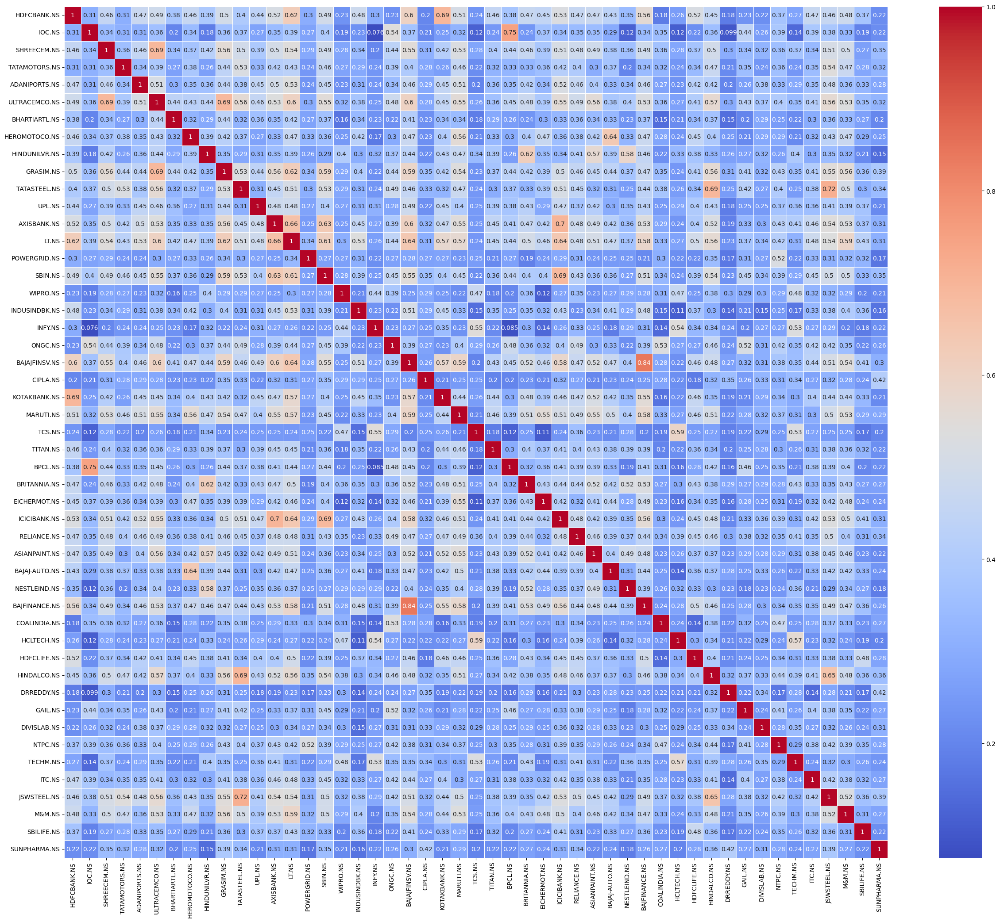

[*********************100%%**********************]  1 of 1 completed

Cluster 1: ['TATAMOTORS.NS', 'ONGC.NS', 'BPCL.NS', 'RELIANCE.NS', 'ITC.NS']
Cluster 2: ['TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 3: ['SHREECEM.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'MARUTI.NS', 'M&M.NS']
Cluster 4: ['HDFCBANK.NS', 'AXISBANK.NS', 'LT.NS', 'SBIN.NS', 'BAJAJFINSV.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 5: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 6: ['IOC.NS', 'BHARTIARTL.NS', 'POWERGRID.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS', 'SBILIFE.NS']
Cluster 7: ['HEROMOTOCO.NS', 'INDUSINDBK.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS']
Cluster 8: ['ADANIPORTS.NS', 'UPL.NS', 'KOTAKBANK.NS', 'TITAN.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'HDFCLIFE.NS']
Cluster 9: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 10: ['HINDUNILVR.NS', 'NESTLEIND.NS']
{'HDFCBANK.NS':                                  Open       Close   Returns
Date                                                       
2018-04-03 00:00:00+05:30  909.921365  906.114197  


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2020-04-02 to 2022-04-02 Return: 118.59%
NIFTY 500 from 2020-04-02 to 2022-04-02 Return: 127.27%
SENSEX from 2020-04-02 to 2022-04-02 Return: 114.84%
{'RELIANCE.NS':                                   Open        Close    Returns
Date                                                          
2020-04-03 00:00:00+05:30  1022.511986   971.136230   0.000000
2020-04-07 00:00:00+05:30   993.353869  1087.092041  11.940221
2020-04-08 00:00:00+05:30  1063.567427  1074.518555  -1.156617
2020-04-09 00:00:00+05:30  1094.212509  1099.575439   2.331917
2020-04-13 00:00:00+05:30  1085.154214  1071.814575  -2.524689
...                                ...          ...        ...
2022-03-28 00:00:00+05:30  2392.742295  2403.697754   1.005454
2022-03-29 00:00:00+05:30  2418.411648  2404.247803   0.022883
2022-03-30 00:00:00+05:30  2420.153745  2450.452637   1.921800
2022-03-31 00:00:00+05:30  2443.118432  2415.432129  -1.429144
2022-04-01 00:00:00+05:30  2416.578212  2434.775879   0.800840



ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


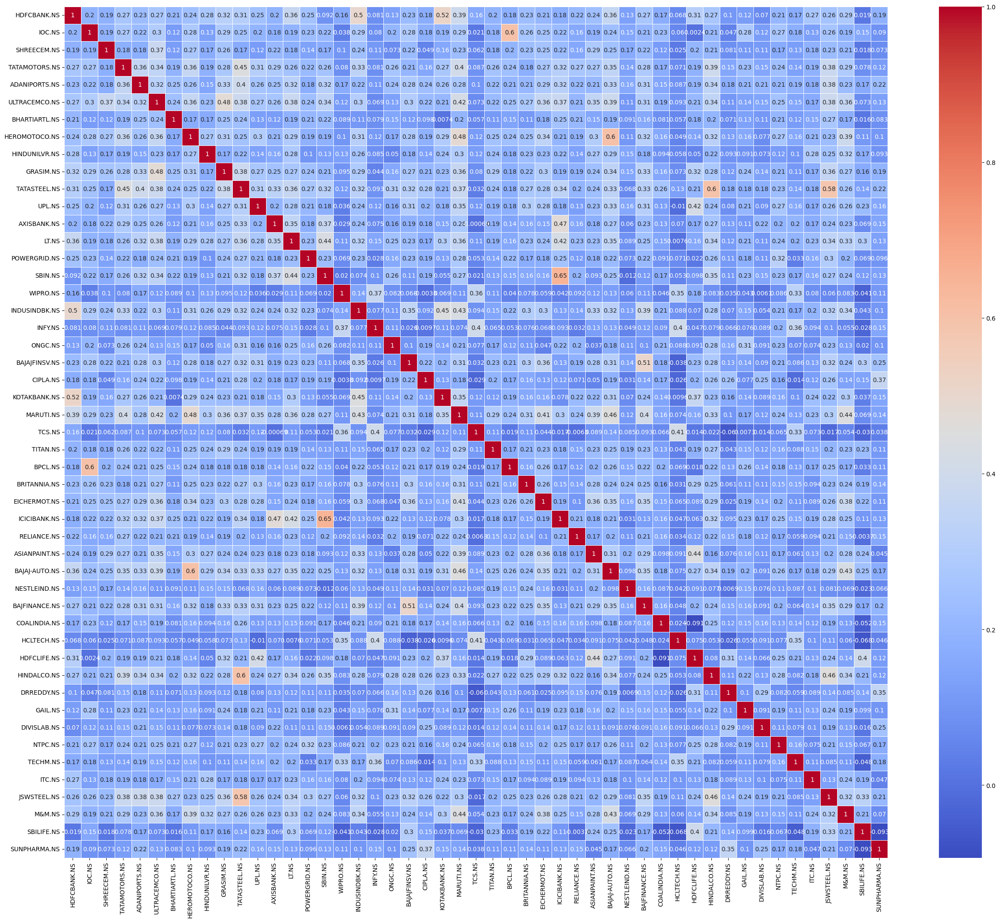

Cluster 1: ['IOC.NS', 'TITAN.NS', 'BPCL.NS']
Cluster 2: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 3: ['SHREECEM.NS', 'HINDUNILVR.NS', 'UPL.NS', 'BAJAJFINSV.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS', 'HDFCLIFE.NS']
Cluster 4: ['AXISBANK.NS', 'LT.NS', 'SBIN.NS', 'ICICIBANK.NS']
Cluster 5: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SBILIFE.NS', 'SUNPHARMA.NS']
Cluster 6: ['BHARTIARTL.NS', 'ONGC.NS', 'RELIANCE.NS', 'NESTLEIND.NS', 'COALINDIA.NS', 'GAIL.NS', 'ITC.NS']
Cluster 7: ['HDFCBANK.NS', 'INDUSINDBK.NS', 'KOTAKBANK.NS']
Cluster 8: ['HEROMOTOCO.NS', 'GRASIM.NS', 'MARUTI.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS', 'BAJFINANCE.NS', 'M&M.NS']
Cluster 9: ['TATAMOTORS.NS', 'ADANIPORTS.NS', 'ULTRACEMCO.NS', 'TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 10: ['POWERGRID.NS', 'NTPC.NS']
{'HDFCBANK.NS':                                  Open       Close   Returns
Date                                                       
2016-04-04 00:00:00+05:30  496.380851  498.174988  

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2018-04-03 to 2020-04-02 Return: -19.44%
NIFTY 500 from 2018-04-03 to 2020-04-02 Return: -25.49%
SENSEX from 2018-04-03 to 2020-04-02 Return: -15.30%
{'TITAN.NS':                                  Open       Close   Returns
Date                                                       
2018-04-03 00:00:00+05:30  910.631417  898.151062  0.000000
2018-04-04 00:00:00+05:30  905.619939  871.551941 -2.961542
2018-04-05 00:00:00+05:30  881.815838  886.682678  1.736068
2018-04-06 00:00:00+05:30  888.561938  906.198242  2.200964
2018-04-09 00:00:00+05:30  915.546400  925.810181  2.164200
...                               ...         ...       ...
2020-03-26 00:00:00+05:30  874.301554  906.831421  5.392826
2020-03-27 00:00:00+05:30  937.798218  915.378967  0.942573
2020-03-30 00:00:00+05:30  841.087767  921.826355  0.704341
2020-03-31 00:00:00+05:30  944.636372  912.106506 -1.054412
2020-04-01 00:00:00+05:30  908.199100  914.402222  0.251694

[492 rows x 3 columns]}
Portfolio average 

In [101]:
total_cases = 0
works = 0
overall_data = []
for case in test_cases:
    for c in case:
        worked, overall_data = perform_portfolio_logic(f"{c[0]}", f"{c[1]}", overall_data, all_symbols)
        if worked:
            works += 1
        total_cases += 1

print(f"Worked {(works/total_cases) * 100}% times")


2020-04-01 2024-08-11


ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


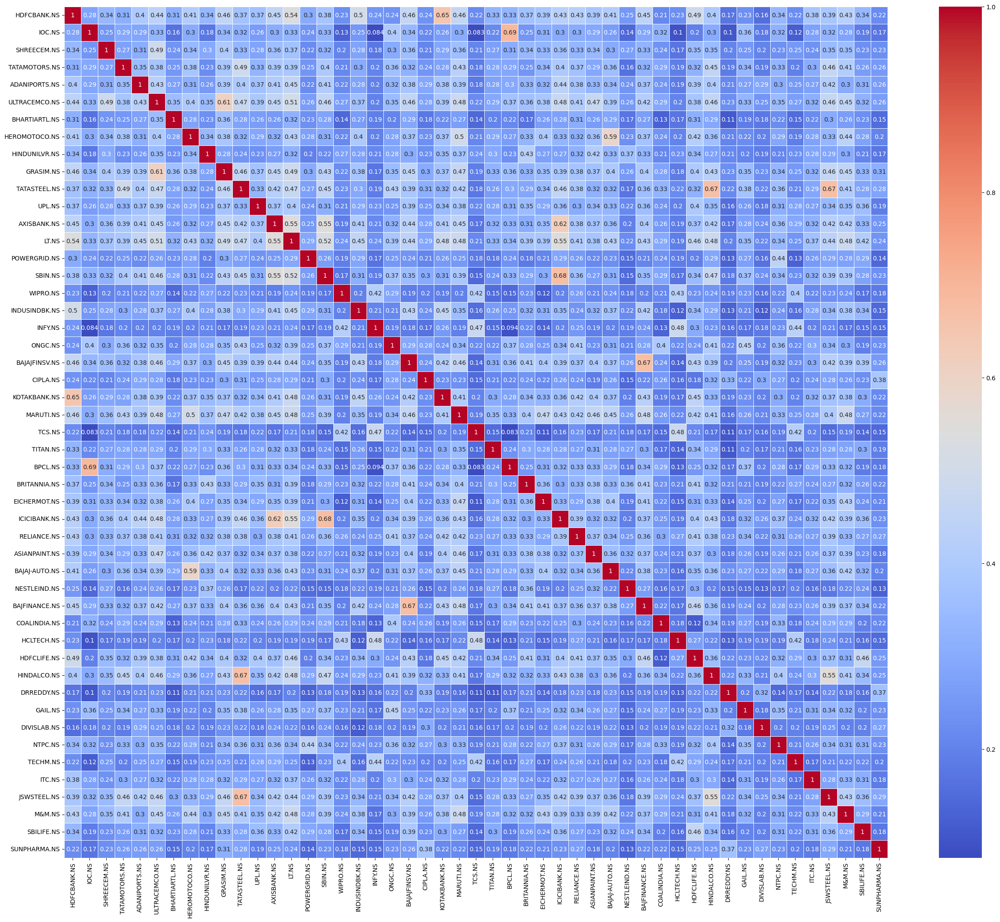

Cluster 1: ['IOC.NS', 'ONGC.NS', 'BPCL.NS', 'GAIL.NS', 'NTPC.NS', 'ITC.NS']
Cluster 2: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 3: ['ADANIPORTS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'AXISBANK.NS', 'LT.NS', 'SBIN.NS', 'ICICIBANK.NS', 'M&M.NS']
Cluster 4: ['TATAMOTORS.NS', 'TATASTEEL.NS', 'HINDALCO.NS', 'JSWSTEEL.NS']
Cluster 5: ['SHREECEM.NS', 'HINDUNILVR.NS', 'TITAN.NS', 'BRITANNIA.NS', 'ASIANPAINT.NS']
Cluster 6: ['HEROMOTOCO.NS', 'MARUTI.NS', 'EICHERMOT.NS', 'BAJAJ-AUTO.NS']
Cluster 7: ['UPL.NS', 'RELIANCE.NS', 'HDFCLIFE.NS', 'SBILIFE.NS']
Cluster 8: ['HDFCBANK.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'KOTAKBANK.NS', 'BAJFINANCE.NS']
Cluster 9: ['BHARTIARTL.NS', 'POWERGRID.NS', 'NESTLEIND.NS', 'COALINDIA.NS']
Cluster 10: ['CIPLA.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
{'HDFCBANK.NS':                                  Open       Close    Returns
Date                                                        
2015-04-01 00:00:00+05:30  474.593138  477.900177

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


NIFTY 50 from 2020-04-01 to 2024-08-11 Return: 195.23%
NIFTY 500 from 2020-04-01 to 2024-08-11 Return: 239.01%
SENSEX from 2020-04-01 to 2024-08-11 Return: 181.99%
{'BPCL.NS':                                  Open       Close    Returns
Date                                                        
2020-04-01 00:00:00+05:30  120.750049  117.247528   0.000000
2020-04-03 00:00:00+05:30  116.492848  122.743210   4.687247
2020-04-07 00:00:00+05:30  126.555338  135.882507  10.704704
2020-04-08 00:00:00+05:30  135.456816  132.476761  -2.506391
2020-04-09 00:00:00+05:30  133.579772  133.483017   0.759572
...                               ...         ...        ...
2024-08-05 00:00:00+05:30  331.385159  331.094482  -1.555746
2024-08-06 00:00:00+05:30  332.354113  324.311737  -2.048583
2024-08-07 00:00:00+05:30  330.610007  332.983948   2.674035
2024-08-08 00:00:00+05:30  333.274649  327.799988  -1.556820
2024-08-09 00:00:00+05:30  333.149994  333.399994   1.708361

[1078 rows x 3 columns]}
Portf

In [102]:
worked, overall_data = perform_portfolio_logic("2015-04-01", "2020-04-01", [], all_symbols)

In [99]:
# ns.get_nifty_50() results in a list of strings

# ns.get_nifty_50_with_ns() results in a list of strings

# ns.get_nifty_50_with_ns('string') results in a string

# Methods Available
# Following are the available methods:

# get_nifty200_with_ns() fetches a list of Nifty 200 stocks with .NS suffix. get_nifty200() fetches a list of Nifty 200 stocks.

# get_nifty500_with_ns() fetches a list of Nifty 500 stocks with .NS suffix. get_nifty500() fetches a list of Nifty 500 stocks.

# get_nifty50_with_ns() fetches a list of Nifty 50 stocks with .NS suffix. get_nifty50() fetches a list of Nifty 50 stocks.

# get_nifty100_with_ns() fetches a list of Nifty 100 stocks with .NS suffix. get_nifty100() fetches a list of Nifty 100 stocks.

# get_nifty_auto_with_ns() fetches a list of Nifty Auto stocks with .NS suffix. get_nifty_auto() fetches a list of Nifty 100 stocks.

# get_nifty_energy_with_ns() fetches a list of Nifty Energy stocks with .NS suffix. get_nifty_energy() fetches a list of Nifty Energy stocks.

# get_nifty_financial_services_with_ns() fetches a list of Nifty Financial Services stocks with .NS suffix. get_nifty_financial_services() fetches a list of Nifty Financial Services stocks.

# get_nifty_fmcg_with_ns() fetches a list of Nifty FMCG stocks with .NS suffix. get_nifty_fmcg() fetches a list of Nifty FMCG stocks.

# get_nifty_it_with_ns() fetches a list of Nifty IT stocks with .NS suffix. get_nifty_it() fetches a list of Nifty IT stocks.

# get_nifty_large_midcap250_with_ns() fetches a list of Nifty Large Midcap 250 stocks with .NS suffix. get_nifty_large_midcap250() fetches a list of Nifty Large Midcap 250 stocks.

# get_nifty_media_with_ns() fetches a list of Nifty Media stocks with .NS suffix. get_nifty_media() fetches a list of Nifty Media stocks.

# get_nifty_metal_with_ns() fetches a list of Nifty Metal stocks with .NS suffix. get_nifty_metal() fetches a list of Nifty Metal stocks.

# get_nifty_midcap50_with_ns() fetches a list of Nifty Midcap 50 stocks with .NS suffix. get_nifty_midcap50() fetches a list of Nifty Midcap 50 stocks.

# get_nifty_midcap100_with_ns() fetches a list of Nifty Midcap 100 stocks with .NS suffix. get_nifty_midcap100() fetches a list of Nifty Midcap 100 stocks.

# get_nifty_midcap150_with_ns() fetches a list of Nifty Midcap 150 stocks with .NS suffix. get_nifty_midcap150() fetches a list of Nifty Midcap 150 stocks.

# get_nifty_mid_smallcap400_with_ns() fetches a list of Nifty Mid Smallcap 400 stocks with .NS suffix. get_nifty_mid_smallcap400() fetches a list of Nifty Mid Smallcap 400 stocks.

# get_nifty_next50_with_ns() fetches a list of Nifty Next 50 stocks with .NS suffix. get_nifty_next50() fetches a list of Nifty Next 50 stocks.

# get_nifty_pharma_with_ns() fetches a list of Nifty Pharma stocks with .NS suffix. get_nifty_pharma() fetches a list of Nifty Pharma stocks.

# get_nifty_private_bank_with_ns() fetches a list of Nifty Private Bank stocks with .NS suffix. get_nifty_private_bank() fetches a list of Nifty Private Bank stocks.

# get_nifty_psu_bank_with_ns() fetches a list of Nifty PSU Bank stocks with .NS suffix. get_nifty_psu_bank() fetches a list of Nifty PSU Bank stocks

# get_nifty_realty_with_ns() fetches a list of Nifty Realty stocks with .NS suffix. get_nifty_realty() fetches a list of Nifty Realty stocks.

# get_nifty_smallcap50_with_ns() fetches a list of Nifty Smallcap 50 stocks with .NS suffix. get_nifty_smallcap50() fetches a list of Nifty Smallcap 50 stocks.

# get_nifty_smallcap100_with_ns() fetches a list of Nifty Smallcap 100 stocks with .NS suffix. get_nifty_smallcap100() fetches a list of Nifty Smallcap 100 stocks.

# get_nifty_smallcap250_with_ns() fetches a list of Nifty Smallcap 250 stocks with .NS suffix. get_nifty_smallcap250_with_ns() fetches a list of Nifty Smallcap 250 stocks.

ERROR:yfinance:$HDFC.NS: possibly delisted; No timezone found


Problem at HDFC.NS
['HDFC.NS', 'NAN']


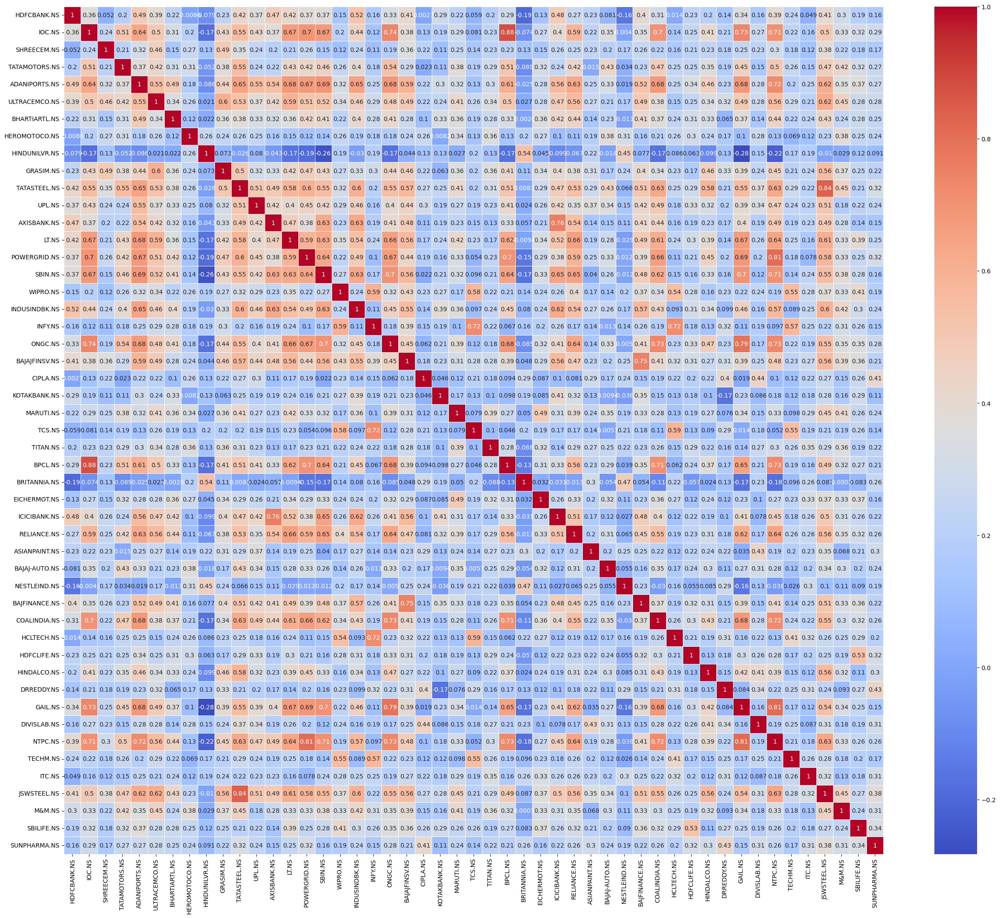

Cluster 1: ['WIPRO.NS', 'INFY.NS', 'TCS.NS', 'HCLTECH.NS', 'TECHM.NS']
Cluster 2: ['HINDUNILVR.NS', 'BRITANNIA.NS', 'NESTLEIND.NS']
Cluster 3: ['HDFCBANK.NS', 'UPL.NS', 'AXISBANK.NS', 'INDUSINDBK.NS', 'BAJAJFINSV.NS', 'ICICIBANK.NS', 'BAJFINANCE.NS']
Cluster 4: ['SHREECEM.NS', 'CIPLA.NS', 'ASIANPAINT.NS', 'BAJAJ-AUTO.NS', 'DRREDDY.NS', 'DIVISLAB.NS', 'SUNPHARMA.NS']
Cluster 5: ['HEROMOTOCO.NS', 'KOTAKBANK.NS', 'TITAN.NS', 'EICHERMOT.NS', 'HDFCLIFE.NS', 'ITC.NS', 'SBILIFE.NS']
Cluster 6: ['TATASTEEL.NS', 'JSWSTEEL.NS']
Cluster 7: ['IOC.NS', 'POWERGRID.NS', 'ONGC.NS', 'BPCL.NS', 'COALINDIA.NS', 'GAIL.NS', 'NTPC.NS']
Cluster 8: ['ADANIPORTS.NS', 'LT.NS', 'SBIN.NS', 'RELIANCE.NS']
Cluster 9: ['TATAMOTORS.NS', 'ULTRACEMCO.NS', 'GRASIM.NS', 'MARUTI.NS', 'M&M.NS']
Cluster 10: ['BHARTIARTL.NS', 'HINDALCO.NS']
{'HDFCBANK.NS':                                   Open        Close   Returns
Date                                                         
2024-02-12 00:00:00+05:30  1380.794683  1371.27

,Return
Stock,
TECHM.NS,16.364401
INFY.NS,5.989518
BRITANNIA.NS,16.997622
HINDUNILVR.NS,16.277119
UPL.NS,20.986034
HDFCBANK.NS,20.340585
DIVISLAB.NS,29.930480
BAJAJ-AUTO.NS,25.739250
EICHERMOT.NS,26.144426


In [100]:
make_portfolio("2024-02-11", "2024-08-11", all_symbols)